# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [125]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [126]:
!mkdir data

mkdir: data: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [127]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [128]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

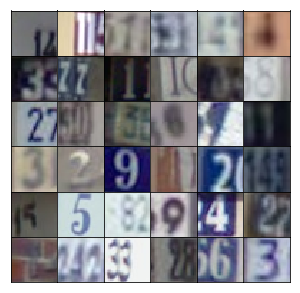

In [129]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [130]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [131]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [132]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [133]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        h1 = tf.layers.dense(z, 4 *4*512)
        # Reshape it to start the convolution network
        h1 = tf.reshape(h1, (-1, 4, 4, 512))
        h1 = tf.layers.batch_normalization(h1, training=training)
        h1 = tf.maximum(alpha * h1, h1) # LRelu
        # 4x4x512 now
        
        h2 = tf.layers.conv2d_transpose(h1, 256, 5, strides=2, padding='same')
        h2 = tf.layers.batch_normalization(h2, training=training)
        h2 = tf.maximum(alpha * h2, h2)
        # 8x8x256 now
        
        h3 = tf.layers.conv2d_transpose(h2, 128, 5, strides=2, padding='same')
        h3 = tf.layers.batch_normalization(h3, training=training)
        h3 = tf.maximum(alpha * h3, h3)
        # 16x16x128 now 
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(h3, output_dim, 5, strides=2, padding='same')
        #32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [134]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        h1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        h1 = tf.maximum(alpha * h1, h1) # LRelu
        # 16x16x32
        
        h2 = tf.layers.conv2d(h1, 128, 5, strides=2, padding='same')
        h2 = tf.layers.batch_normalization(h2, training=True)
        h2 = tf.maximum(alpha * h2, h2) # LRelu
        # 8x8x128
        
        h3 = tf.layers.conv2d(h2, 256, 5, strides=2, padding='same')
        h3 = tf.layers.batch_normalization(h3, training=True)
        h3 = tf.maximum(alpha * h3, h3) # LRelu
        # 4x4x256
        
        # Flatten it
        flat = tf.reshape(h3, (-1, 4, 4, 256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [135]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [136]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [137]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [138]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [139]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [140]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0005
batch_size = 128
epochs = 20
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/20... Discriminator Loss: 1.1636... Generator Loss: 0.6980
Epoch 1/20... Discriminator Loss: 0.9788... Generator Loss: 0.9427
Epoch 1/20... Discriminator Loss: 0.8519... Generator Loss: 1.0966
Epoch 1/20... Discriminator Loss: 0.9038... Generator Loss: 1.0351
Epoch 1/20... Discriminator Loss: 1.0880... Generator Loss: 0.8280
Epoch 1/20... Discriminator Loss: 1.1486... Generator Loss: 0.7915
Epoch 1/20... Discriminator Loss: 1.2680... Generator Loss: 0.8049
Epoch 1/20... Discriminator Loss: 1.3105... Generator Loss: 0.9460
Epoch 1/20... Discriminator Loss: 1.0937... Generator Loss: 0.8967
Epoch 1/20... Discriminator Loss: 1.2370... Generator Loss: 0.7875


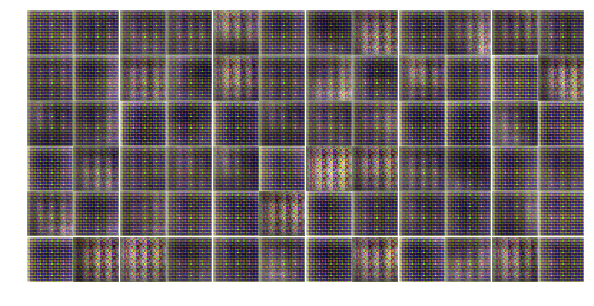

Epoch 1/20... Discriminator Loss: 1.1728... Generator Loss: 1.0130
Epoch 1/20... Discriminator Loss: 1.2131... Generator Loss: 0.7592
Epoch 1/20... Discriminator Loss: 1.1920... Generator Loss: 0.7586
Epoch 1/20... Discriminator Loss: 1.3087... Generator Loss: 0.7344
Epoch 1/20... Discriminator Loss: 1.4485... Generator Loss: 0.7327
Epoch 1/20... Discriminator Loss: 1.2810... Generator Loss: 0.7468
Epoch 1/20... Discriminator Loss: 1.5699... Generator Loss: 0.5952
Epoch 1/20... Discriminator Loss: 1.3987... Generator Loss: 0.7418
Epoch 1/20... Discriminator Loss: 1.4196... Generator Loss: 0.7553
Epoch 1/20... Discriminator Loss: 1.3177... Generator Loss: 0.7678


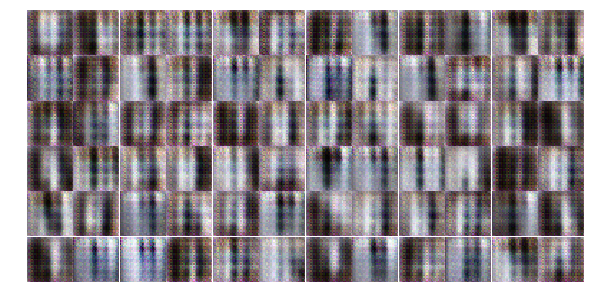

Epoch 1/20... Discriminator Loss: 1.3267... Generator Loss: 0.7747
Epoch 1/20... Discriminator Loss: 1.4121... Generator Loss: 0.6708
Epoch 1/20... Discriminator Loss: 1.3407... Generator Loss: 0.7312
Epoch 1/20... Discriminator Loss: 1.3652... Generator Loss: 0.7406
Epoch 1/20... Discriminator Loss: 1.2974... Generator Loss: 0.7775
Epoch 1/20... Discriminator Loss: 1.2962... Generator Loss: 0.7553
Epoch 1/20... Discriminator Loss: 1.4061... Generator Loss: 0.8058
Epoch 1/20... Discriminator Loss: 1.4174... Generator Loss: 0.6595
Epoch 1/20... Discriminator Loss: 1.3758... Generator Loss: 0.6812
Epoch 1/20... Discriminator Loss: 1.3546... Generator Loss: 0.7333


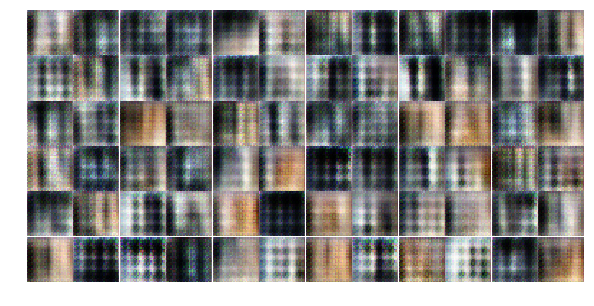

Epoch 1/20... Discriminator Loss: 1.3011... Generator Loss: 0.7340
Epoch 1/20... Discriminator Loss: 1.3373... Generator Loss: 0.7112
Epoch 1/20... Discriminator Loss: 1.3156... Generator Loss: 0.7195
Epoch 1/20... Discriminator Loss: 1.3387... Generator Loss: 0.7118
Epoch 1/20... Discriminator Loss: 1.2902... Generator Loss: 0.7698
Epoch 1/20... Discriminator Loss: 1.3133... Generator Loss: 0.7171
Epoch 1/20... Discriminator Loss: 1.3263... Generator Loss: 0.7336
Epoch 1/20... Discriminator Loss: 1.3730... Generator Loss: 0.7199
Epoch 1/20... Discriminator Loss: 1.3948... Generator Loss: 0.7176
Epoch 1/20... Discriminator Loss: 1.3596... Generator Loss: 0.6819


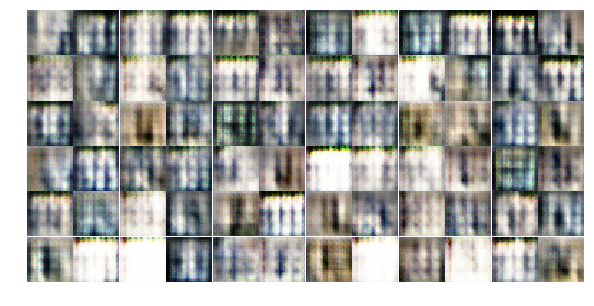

Epoch 1/20... Discriminator Loss: 1.2911... Generator Loss: 0.7765
Epoch 1/20... Discriminator Loss: 1.3545... Generator Loss: 0.7253
Epoch 1/20... Discriminator Loss: 1.3383... Generator Loss: 0.7026
Epoch 1/20... Discriminator Loss: 1.3488... Generator Loss: 0.7856
Epoch 1/20... Discriminator Loss: 1.3838... Generator Loss: 0.6681
Epoch 1/20... Discriminator Loss: 1.3527... Generator Loss: 0.7549
Epoch 1/20... Discriminator Loss: 1.3494... Generator Loss: 0.6917
Epoch 1/20... Discriminator Loss: 1.3010... Generator Loss: 0.7294
Epoch 1/20... Discriminator Loss: 1.2460... Generator Loss: 0.7714
Epoch 1/20... Discriminator Loss: 1.2415... Generator Loss: 0.7909


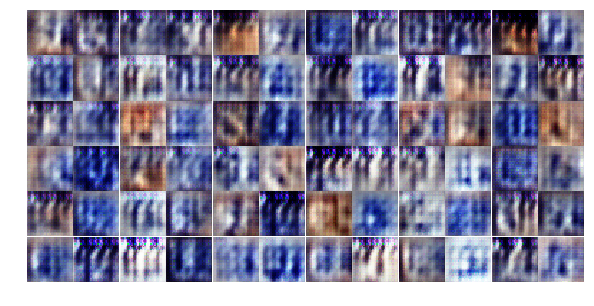

Epoch 1/20... Discriminator Loss: 1.3893... Generator Loss: 0.7190
Epoch 1/20... Discriminator Loss: 1.3672... Generator Loss: 0.6639
Epoch 1/20... Discriminator Loss: 1.3348... Generator Loss: 0.7295
Epoch 1/20... Discriminator Loss: 1.3179... Generator Loss: 0.7381
Epoch 1/20... Discriminator Loss: 1.3562... Generator Loss: 0.7058
Epoch 1/20... Discriminator Loss: 1.4860... Generator Loss: 0.9204
Epoch 1/20... Discriminator Loss: 1.2259... Generator Loss: 0.8457
Epoch 2/20... Discriminator Loss: 1.5565... Generator Loss: 0.8924
Epoch 2/20... Discriminator Loss: 1.3404... Generator Loss: 0.7510
Epoch 2/20... Discriminator Loss: 1.3377... Generator Loss: 0.7423


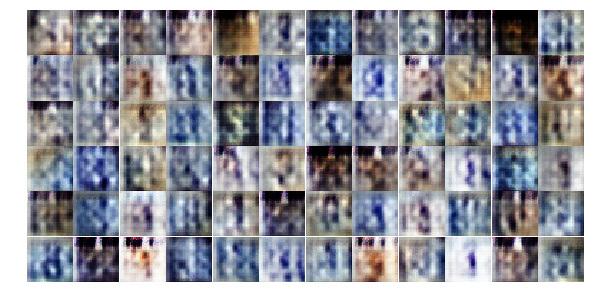

Epoch 2/20... Discriminator Loss: 1.3377... Generator Loss: 0.7671
Epoch 2/20... Discriminator Loss: 1.3130... Generator Loss: 0.8376
Epoch 2/20... Discriminator Loss: 1.3100... Generator Loss: 0.7603
Epoch 2/20... Discriminator Loss: 1.2710... Generator Loss: 0.8162
Epoch 2/20... Discriminator Loss: 1.3525... Generator Loss: 0.8026
Epoch 2/20... Discriminator Loss: 1.2175... Generator Loss: 0.7874
Epoch 2/20... Discriminator Loss: 1.3795... Generator Loss: 0.6868
Epoch 2/20... Discriminator Loss: 1.3720... Generator Loss: 0.7624
Epoch 2/20... Discriminator Loss: 1.1881... Generator Loss: 0.7894
Epoch 2/20... Discriminator Loss: 1.1873... Generator Loss: 0.7819


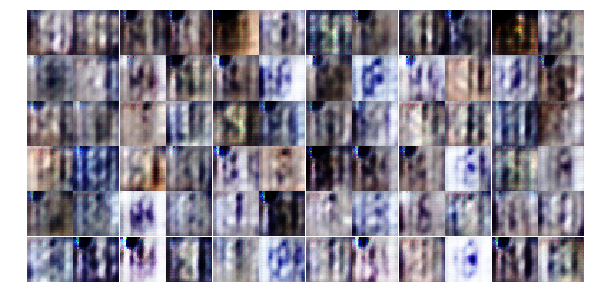

Epoch 2/20... Discriminator Loss: 1.3597... Generator Loss: 0.6618
Epoch 2/20... Discriminator Loss: 1.1561... Generator Loss: 0.7838
Epoch 2/20... Discriminator Loss: 1.6874... Generator Loss: 0.8189
Epoch 2/20... Discriminator Loss: 1.3639... Generator Loss: 0.6460
Epoch 2/20... Discriminator Loss: 1.3966... Generator Loss: 0.6737
Epoch 2/20... Discriminator Loss: 1.3850... Generator Loss: 0.6895
Epoch 2/20... Discriminator Loss: 1.3626... Generator Loss: 0.7127
Epoch 2/20... Discriminator Loss: 1.3591... Generator Loss: 0.7129
Epoch 2/20... Discriminator Loss: 1.3495... Generator Loss: 0.6805
Epoch 2/20... Discriminator Loss: 1.3694... Generator Loss: 0.7306


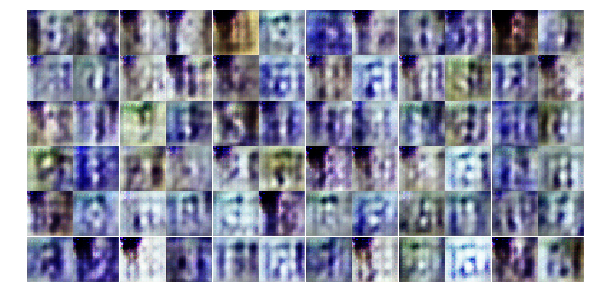

Epoch 2/20... Discriminator Loss: 1.3634... Generator Loss: 0.7522
Epoch 2/20... Discriminator Loss: 1.3221... Generator Loss: 0.7420
Epoch 2/20... Discriminator Loss: 1.3566... Generator Loss: 0.7561
Epoch 2/20... Discriminator Loss: 1.2254... Generator Loss: 0.7914
Epoch 2/20... Discriminator Loss: 1.3469... Generator Loss: 0.7402
Epoch 2/20... Discriminator Loss: 1.3015... Generator Loss: 0.7287
Epoch 2/20... Discriminator Loss: 1.1622... Generator Loss: 0.8395
Epoch 2/20... Discriminator Loss: 1.3058... Generator Loss: 0.8345
Epoch 2/20... Discriminator Loss: 1.2529... Generator Loss: 0.8187
Epoch 2/20... Discriminator Loss: 1.2388... Generator Loss: 0.8958


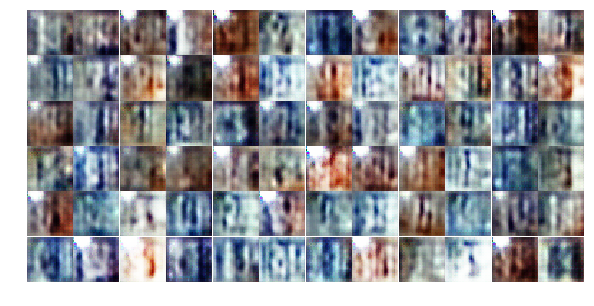

Epoch 2/20... Discriminator Loss: 1.2233... Generator Loss: 0.9574
Epoch 2/20... Discriminator Loss: 1.2233... Generator Loss: 0.8816
Epoch 2/20... Discriminator Loss: 1.1877... Generator Loss: 0.9902
Epoch 2/20... Discriminator Loss: 1.2347... Generator Loss: 0.7948
Epoch 2/20... Discriminator Loss: 1.2079... Generator Loss: 0.8107
Epoch 2/20... Discriminator Loss: 1.2293... Generator Loss: 0.7934
Epoch 2/20... Discriminator Loss: 1.0950... Generator Loss: 1.0397
Epoch 2/20... Discriminator Loss: 1.2865... Generator Loss: 1.0970
Epoch 2/20... Discriminator Loss: 1.3002... Generator Loss: 0.7012
Epoch 2/20... Discriminator Loss: 1.2699... Generator Loss: 0.9137


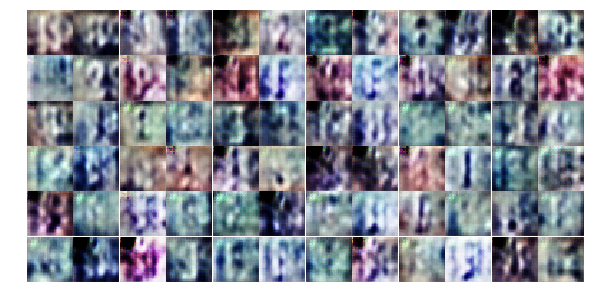

Epoch 2/20... Discriminator Loss: 1.0747... Generator Loss: 1.2167
Epoch 2/20... Discriminator Loss: 1.0891... Generator Loss: 1.0779
Epoch 2/20... Discriminator Loss: 1.1910... Generator Loss: 1.0057
Epoch 2/20... Discriminator Loss: 1.1638... Generator Loss: 0.7948
Epoch 2/20... Discriminator Loss: 1.2003... Generator Loss: 0.8246
Epoch 2/20... Discriminator Loss: 1.2937... Generator Loss: 0.8527
Epoch 2/20... Discriminator Loss: 1.2268... Generator Loss: 0.9373
Epoch 2/20... Discriminator Loss: 1.2319... Generator Loss: 0.9840
Epoch 2/20... Discriminator Loss: 1.1494... Generator Loss: 0.7979
Epoch 2/20... Discriminator Loss: 1.1343... Generator Loss: 1.2062


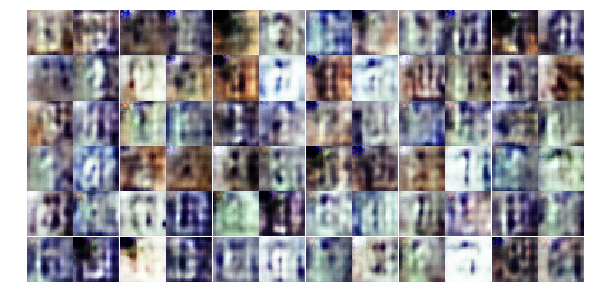

Epoch 2/20... Discriminator Loss: 0.9728... Generator Loss: 1.1154
Epoch 2/20... Discriminator Loss: 1.1488... Generator Loss: 0.8166
Epoch 2/20... Discriminator Loss: 1.2527... Generator Loss: 0.7048
Epoch 2/20... Discriminator Loss: 1.2074... Generator Loss: 0.6457
Epoch 3/20... Discriminator Loss: 1.3892... Generator Loss: 1.0984
Epoch 3/20... Discriminator Loss: 1.0652... Generator Loss: 0.8888
Epoch 3/20... Discriminator Loss: 1.3266... Generator Loss: 0.8424
Epoch 3/20... Discriminator Loss: 1.0977... Generator Loss: 0.8654
Epoch 3/20... Discriminator Loss: 1.0325... Generator Loss: 0.9295
Epoch 3/20... Discriminator Loss: 1.6769... Generator Loss: 0.7108


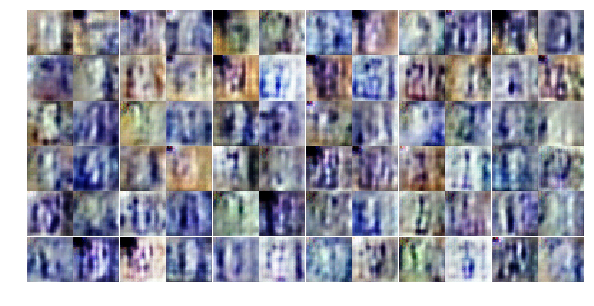

Epoch 3/20... Discriminator Loss: 1.3436... Generator Loss: 0.7257
Epoch 3/20... Discriminator Loss: 1.2630... Generator Loss: 0.7478
Epoch 3/20... Discriminator Loss: 1.2785... Generator Loss: 0.7365
Epoch 3/20... Discriminator Loss: 1.2179... Generator Loss: 0.8472
Epoch 3/20... Discriminator Loss: 1.3410... Generator Loss: 0.8888
Epoch 3/20... Discriminator Loss: 1.2499... Generator Loss: 0.8083
Epoch 3/20... Discriminator Loss: 1.0445... Generator Loss: 1.0795
Epoch 3/20... Discriminator Loss: 1.5709... Generator Loss: 0.8963
Epoch 3/20... Discriminator Loss: 1.1110... Generator Loss: 0.8567
Epoch 3/20... Discriminator Loss: 1.0889... Generator Loss: 0.8918


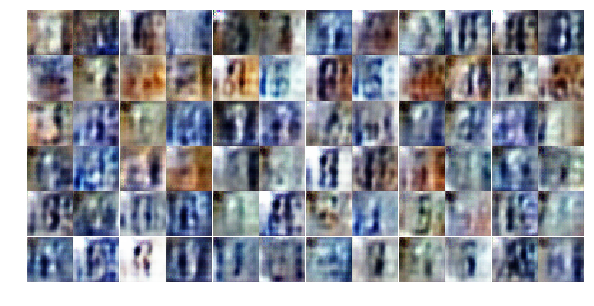

Epoch 3/20... Discriminator Loss: 1.2027... Generator Loss: 0.7302
Epoch 3/20... Discriminator Loss: 0.9434... Generator Loss: 0.9681
Epoch 3/20... Discriminator Loss: 1.2345... Generator Loss: 0.7136
Epoch 3/20... Discriminator Loss: 1.2677... Generator Loss: 0.6388
Epoch 3/20... Discriminator Loss: 1.2387... Generator Loss: 0.7228
Epoch 3/20... Discriminator Loss: 1.4070... Generator Loss: 0.7207
Epoch 3/20... Discriminator Loss: 1.1146... Generator Loss: 0.7401
Epoch 3/20... Discriminator Loss: 1.0258... Generator Loss: 0.9173
Epoch 3/20... Discriminator Loss: 1.0638... Generator Loss: 0.8638
Epoch 3/20... Discriminator Loss: 1.0380... Generator Loss: 1.3014


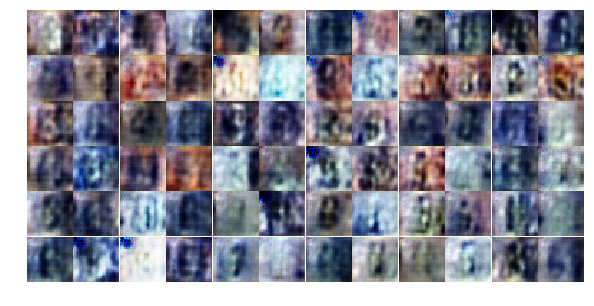

Epoch 3/20... Discriminator Loss: 1.2592... Generator Loss: 1.0528
Epoch 3/20... Discriminator Loss: 0.8516... Generator Loss: 1.3296
Epoch 3/20... Discriminator Loss: 1.3169... Generator Loss: 0.5824
Epoch 3/20... Discriminator Loss: 1.3424... Generator Loss: 0.8599
Epoch 3/20... Discriminator Loss: 1.4467... Generator Loss: 0.7039
Epoch 3/20... Discriminator Loss: 1.3917... Generator Loss: 0.7037
Epoch 3/20... Discriminator Loss: 1.3687... Generator Loss: 0.7349
Epoch 3/20... Discriminator Loss: 1.1042... Generator Loss: 0.8176
Epoch 3/20... Discriminator Loss: 1.4531... Generator Loss: 0.7579
Epoch 3/20... Discriminator Loss: 1.0529... Generator Loss: 0.8900


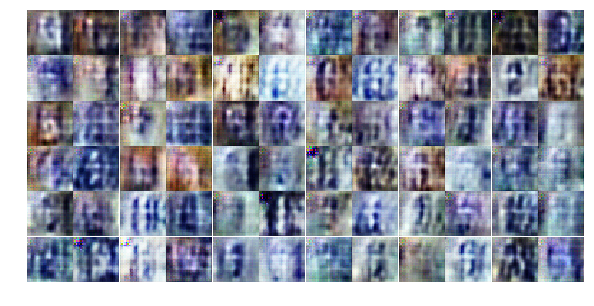

Epoch 3/20... Discriminator Loss: 1.2462... Generator Loss: 0.9314
Epoch 3/20... Discriminator Loss: 1.1111... Generator Loss: 0.7740
Epoch 3/20... Discriminator Loss: 1.2028... Generator Loss: 0.8123
Epoch 3/20... Discriminator Loss: 0.8442... Generator Loss: 1.1630
Epoch 3/20... Discriminator Loss: 1.1234... Generator Loss: 0.7931
Epoch 3/20... Discriminator Loss: 1.2035... Generator Loss: 0.7932
Epoch 3/20... Discriminator Loss: 1.2227... Generator Loss: 0.8212
Epoch 3/20... Discriminator Loss: 1.2812... Generator Loss: 0.7176
Epoch 3/20... Discriminator Loss: 1.4293... Generator Loss: 0.7526
Epoch 3/20... Discriminator Loss: 1.3674... Generator Loss: 0.7151


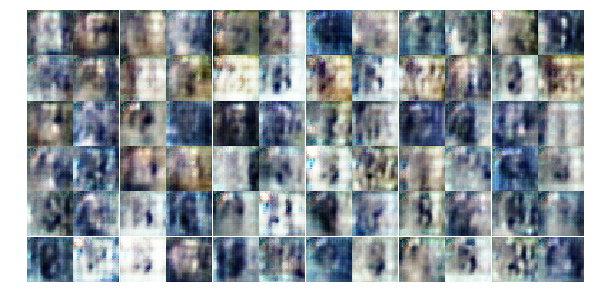

Epoch 3/20... Discriminator Loss: 1.4289... Generator Loss: 0.6474
Epoch 3/20... Discriminator Loss: 1.4009... Generator Loss: 0.7211
Epoch 3/20... Discriminator Loss: 1.4084... Generator Loss: 0.6764
Epoch 3/20... Discriminator Loss: 1.3694... Generator Loss: 0.7384
Epoch 3/20... Discriminator Loss: 1.3593... Generator Loss: 0.7279
Epoch 3/20... Discriminator Loss: 1.3828... Generator Loss: 0.6889
Epoch 3/20... Discriminator Loss: 1.3539... Generator Loss: 0.7326
Epoch 3/20... Discriminator Loss: 1.3524... Generator Loss: 0.6645
Epoch 3/20... Discriminator Loss: 1.3635... Generator Loss: 0.7523
Epoch 3/20... Discriminator Loss: 1.3784... Generator Loss: 0.6819


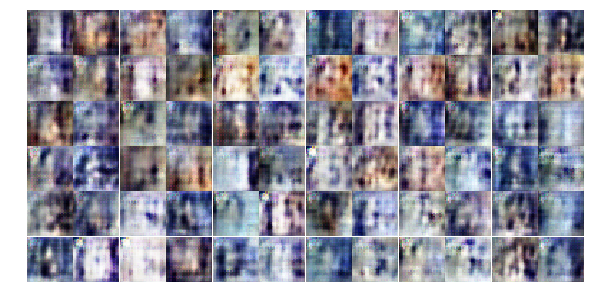

Epoch 3/20... Discriminator Loss: 1.4008... Generator Loss: 0.6990
Epoch 4/20... Discriminator Loss: 1.3506... Generator Loss: 0.7522
Epoch 4/20... Discriminator Loss: 1.3633... Generator Loss: 0.6922
Epoch 4/20... Discriminator Loss: 1.3685... Generator Loss: 0.7057
Epoch 4/20... Discriminator Loss: 1.3661... Generator Loss: 0.7026
Epoch 4/20... Discriminator Loss: 1.3858... Generator Loss: 0.7008
Epoch 4/20... Discriminator Loss: 1.3844... Generator Loss: 0.7050
Epoch 4/20... Discriminator Loss: 1.3787... Generator Loss: 0.7013
Epoch 4/20... Discriminator Loss: 1.4092... Generator Loss: 0.7244
Epoch 4/20... Discriminator Loss: 1.3807... Generator Loss: 0.7011


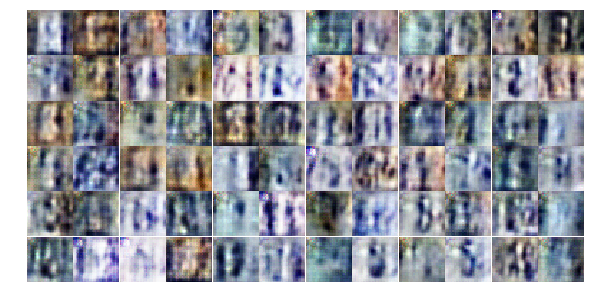

Epoch 4/20... Discriminator Loss: 1.3657... Generator Loss: 0.7052
Epoch 4/20... Discriminator Loss: 1.3720... Generator Loss: 0.7104
Epoch 4/20... Discriminator Loss: 1.3870... Generator Loss: 0.7287
Epoch 4/20... Discriminator Loss: 1.3693... Generator Loss: 0.7093
Epoch 4/20... Discriminator Loss: 1.3649... Generator Loss: 0.7191
Epoch 4/20... Discriminator Loss: 1.3966... Generator Loss: 0.7092
Epoch 4/20... Discriminator Loss: 1.3530... Generator Loss: 0.6932
Epoch 4/20... Discriminator Loss: 1.3768... Generator Loss: 0.6993
Epoch 4/20... Discriminator Loss: 1.4073... Generator Loss: 0.7155
Epoch 4/20... Discriminator Loss: 1.3661... Generator Loss: 0.7074


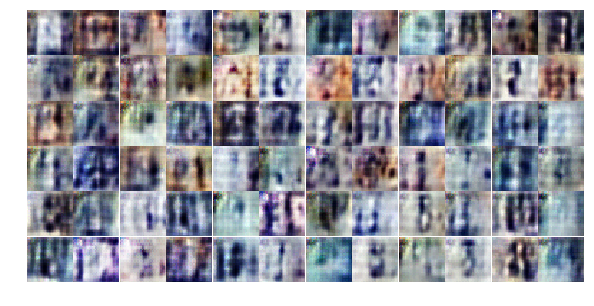

Epoch 4/20... Discriminator Loss: 1.3756... Generator Loss: 0.7114
Epoch 4/20... Discriminator Loss: 1.4018... Generator Loss: 0.6673
Epoch 4/20... Discriminator Loss: 1.3632... Generator Loss: 0.7101
Epoch 4/20... Discriminator Loss: 1.3688... Generator Loss: 0.7024
Epoch 4/20... Discriminator Loss: 1.3773... Generator Loss: 0.7264
Epoch 4/20... Discriminator Loss: 1.3610... Generator Loss: 0.7051
Epoch 4/20... Discriminator Loss: 1.3422... Generator Loss: 0.7298
Epoch 4/20... Discriminator Loss: 1.3823... Generator Loss: 0.7029
Epoch 4/20... Discriminator Loss: 1.3581... Generator Loss: 0.6890
Epoch 4/20... Discriminator Loss: 1.3313... Generator Loss: 0.7074


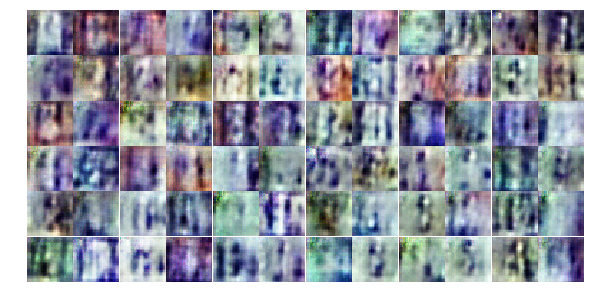

Epoch 4/20... Discriminator Loss: 1.3535... Generator Loss: 0.7070
Epoch 4/20... Discriminator Loss: 1.3646... Generator Loss: 0.7233
Epoch 4/20... Discriminator Loss: 1.4052... Generator Loss: 0.6837
Epoch 4/20... Discriminator Loss: 1.3282... Generator Loss: 0.7121
Epoch 4/20... Discriminator Loss: 1.3930... Generator Loss: 0.6909
Epoch 4/20... Discriminator Loss: 1.3792... Generator Loss: 0.7192
Epoch 4/20... Discriminator Loss: 1.4013... Generator Loss: 0.7175
Epoch 4/20... Discriminator Loss: 1.3404... Generator Loss: 0.7119
Epoch 4/20... Discriminator Loss: 1.3673... Generator Loss: 0.7174
Epoch 4/20... Discriminator Loss: 1.3287... Generator Loss: 0.6877


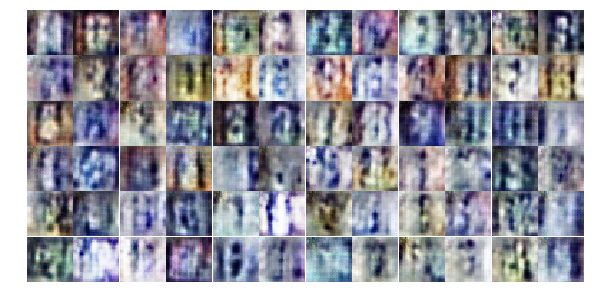

Epoch 4/20... Discriminator Loss: 1.3713... Generator Loss: 0.7025
Epoch 4/20... Discriminator Loss: 1.3483... Generator Loss: 0.7412
Epoch 4/20... Discriminator Loss: 1.3857... Generator Loss: 0.6929
Epoch 4/20... Discriminator Loss: 1.3642... Generator Loss: 0.7060
Epoch 4/20... Discriminator Loss: 1.3596... Generator Loss: 0.7148
Epoch 4/20... Discriminator Loss: 1.3797... Generator Loss: 0.7156
Epoch 4/20... Discriminator Loss: 1.3640... Generator Loss: 0.6839
Epoch 4/20... Discriminator Loss: 1.3702... Generator Loss: 0.7062
Epoch 4/20... Discriminator Loss: 1.3872... Generator Loss: 0.7028
Epoch 4/20... Discriminator Loss: 1.3718... Generator Loss: 0.7171


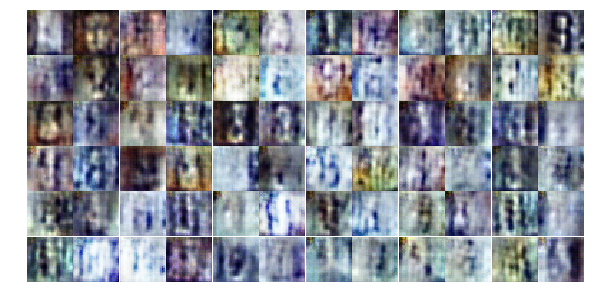

Epoch 4/20... Discriminator Loss: 1.3937... Generator Loss: 0.7221
Epoch 4/20... Discriminator Loss: 1.3796... Generator Loss: 0.6856
Epoch 4/20... Discriminator Loss: 1.3728... Generator Loss: 0.7309
Epoch 4/20... Discriminator Loss: 1.3811... Generator Loss: 0.6676
Epoch 4/20... Discriminator Loss: 1.3523... Generator Loss: 0.6832
Epoch 4/20... Discriminator Loss: 1.3495... Generator Loss: 0.7002
Epoch 4/20... Discriminator Loss: 1.3740... Generator Loss: 0.6650
Epoch 4/20... Discriminator Loss: 1.3202... Generator Loss: 0.7075
Epoch 4/20... Discriminator Loss: 1.3857... Generator Loss: 0.7043
Epoch 5/20... Discriminator Loss: 1.3935... Generator Loss: 0.6831


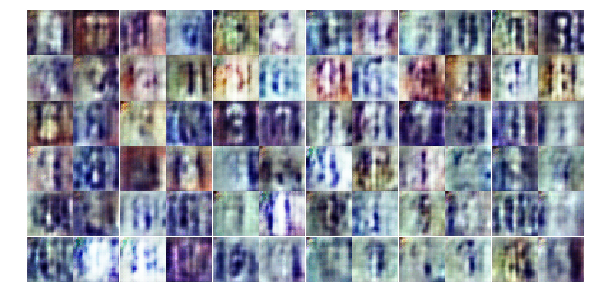

Epoch 5/20... Discriminator Loss: 1.4188... Generator Loss: 0.7353
Epoch 5/20... Discriminator Loss: 1.3363... Generator Loss: 0.7239
Epoch 5/20... Discriminator Loss: 1.3322... Generator Loss: 0.7283
Epoch 5/20... Discriminator Loss: 1.2481... Generator Loss: 0.7250
Epoch 5/20... Discriminator Loss: 1.3307... Generator Loss: 0.7470
Epoch 5/20... Discriminator Loss: 1.3629... Generator Loss: 0.7120
Epoch 5/20... Discriminator Loss: 1.3472... Generator Loss: 0.7020
Epoch 5/20... Discriminator Loss: 1.3627... Generator Loss: 0.6761
Epoch 5/20... Discriminator Loss: 1.3313... Generator Loss: 0.7561
Epoch 5/20... Discriminator Loss: 1.3408... Generator Loss: 0.7262


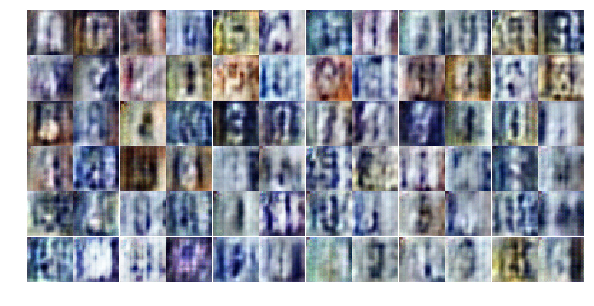

Epoch 5/20... Discriminator Loss: 1.3718... Generator Loss: 0.7074
Epoch 5/20... Discriminator Loss: 1.3549... Generator Loss: 0.7313
Epoch 5/20... Discriminator Loss: 1.2923... Generator Loss: 0.7400
Epoch 5/20... Discriminator Loss: 1.3789... Generator Loss: 0.7041
Epoch 5/20... Discriminator Loss: 1.3673... Generator Loss: 0.7120
Epoch 5/20... Discriminator Loss: 1.3986... Generator Loss: 0.7684
Epoch 5/20... Discriminator Loss: 1.3468... Generator Loss: 0.7031
Epoch 5/20... Discriminator Loss: 1.3692... Generator Loss: 0.7243
Epoch 5/20... Discriminator Loss: 1.3357... Generator Loss: 0.7231
Epoch 5/20... Discriminator Loss: 1.3193... Generator Loss: 0.7395


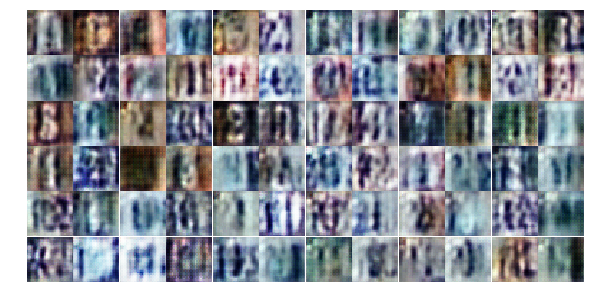

Epoch 5/20... Discriminator Loss: 1.3221... Generator Loss: 0.6859
Epoch 5/20... Discriminator Loss: 1.3687... Generator Loss: 0.7012
Epoch 5/20... Discriminator Loss: 1.4215... Generator Loss: 0.8196
Epoch 5/20... Discriminator Loss: 1.3100... Generator Loss: 0.7623
Epoch 5/20... Discriminator Loss: 1.3383... Generator Loss: 0.7175
Epoch 5/20... Discriminator Loss: 1.3444... Generator Loss: 0.7175
Epoch 5/20... Discriminator Loss: 1.3476... Generator Loss: 0.7166
Epoch 5/20... Discriminator Loss: 1.3305... Generator Loss: 0.7360
Epoch 5/20... Discriminator Loss: 1.4089... Generator Loss: 0.7449
Epoch 5/20... Discriminator Loss: 1.3749... Generator Loss: 0.6994


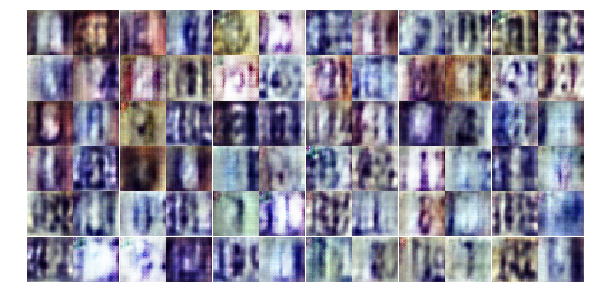

Epoch 5/20... Discriminator Loss: 1.2986... Generator Loss: 0.7018
Epoch 5/20... Discriminator Loss: 1.3510... Generator Loss: 0.7182
Epoch 5/20... Discriminator Loss: 1.3481... Generator Loss: 0.7410
Epoch 5/20... Discriminator Loss: 1.3028... Generator Loss: 0.7875
Epoch 5/20... Discriminator Loss: 1.3413... Generator Loss: 0.7187
Epoch 5/20... Discriminator Loss: 1.3845... Generator Loss: 0.7110
Epoch 5/20... Discriminator Loss: 1.3429... Generator Loss: 0.6668
Epoch 5/20... Discriminator Loss: 1.2986... Generator Loss: 0.7726
Epoch 5/20... Discriminator Loss: 1.3449... Generator Loss: 0.6795
Epoch 5/20... Discriminator Loss: 1.3116... Generator Loss: 0.7387


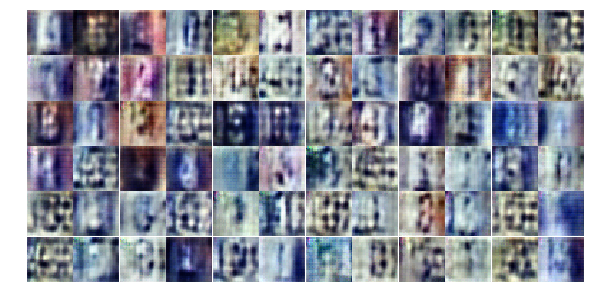

Epoch 5/20... Discriminator Loss: 1.3980... Generator Loss: 0.6859
Epoch 5/20... Discriminator Loss: 1.2795... Generator Loss: 0.7433
Epoch 5/20... Discriminator Loss: 1.3529... Generator Loss: 0.7717
Epoch 5/20... Discriminator Loss: 1.2995... Generator Loss: 0.7424
Epoch 5/20... Discriminator Loss: 1.2746... Generator Loss: 0.7285
Epoch 5/20... Discriminator Loss: 1.4255... Generator Loss: 0.7391
Epoch 5/20... Discriminator Loss: 1.3620... Generator Loss: 0.7400
Epoch 5/20... Discriminator Loss: 1.3114... Generator Loss: 0.7041
Epoch 5/20... Discriminator Loss: 1.3620... Generator Loss: 0.7282
Epoch 5/20... Discriminator Loss: 1.3588... Generator Loss: 0.7453


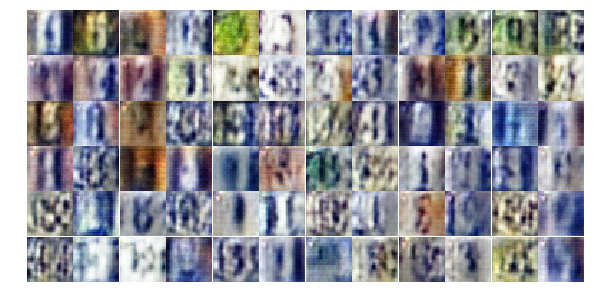

Epoch 5/20... Discriminator Loss: 1.3623... Generator Loss: 0.7017
Epoch 5/20... Discriminator Loss: 1.3732... Generator Loss: 0.7324
Epoch 5/20... Discriminator Loss: 1.3161... Generator Loss: 0.6960
Epoch 5/20... Discriminator Loss: 1.3496... Generator Loss: 0.6994
Epoch 5/20... Discriminator Loss: 1.3520... Generator Loss: 0.7592
Epoch 5/20... Discriminator Loss: 1.3797... Generator Loss: 0.6994
Epoch 6/20... Discriminator Loss: 1.3657... Generator Loss: 0.6755
Epoch 6/20... Discriminator Loss: 1.3536... Generator Loss: 0.7109
Epoch 6/20... Discriminator Loss: 1.3855... Generator Loss: 0.7181
Epoch 6/20... Discriminator Loss: 1.3397... Generator Loss: 0.7446


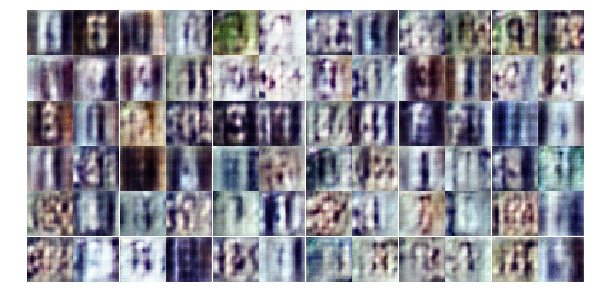

Epoch 6/20... Discriminator Loss: 1.3191... Generator Loss: 0.7008
Epoch 6/20... Discriminator Loss: 1.3365... Generator Loss: 0.6884
Epoch 6/20... Discriminator Loss: 1.3190... Generator Loss: 0.7392
Epoch 6/20... Discriminator Loss: 1.3428... Generator Loss: 0.6811
Epoch 6/20... Discriminator Loss: 1.3529... Generator Loss: 0.6989
Epoch 6/20... Discriminator Loss: 1.2537... Generator Loss: 0.7365
Epoch 6/20... Discriminator Loss: 1.3496... Generator Loss: 0.7017
Epoch 6/20... Discriminator Loss: 1.3458... Generator Loss: 0.7325
Epoch 6/20... Discriminator Loss: 1.3108... Generator Loss: 0.7241
Epoch 6/20... Discriminator Loss: 1.3733... Generator Loss: 0.7359


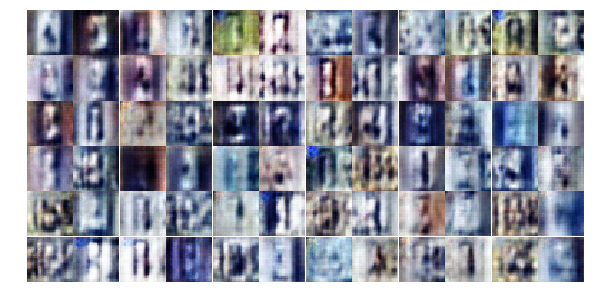

Epoch 6/20... Discriminator Loss: 1.3424... Generator Loss: 0.7451
Epoch 6/20... Discriminator Loss: 1.3363... Generator Loss: 0.7137
Epoch 6/20... Discriminator Loss: 1.2928... Generator Loss: 0.6965
Epoch 6/20... Discriminator Loss: 1.2591... Generator Loss: 0.7225
Epoch 6/20... Discriminator Loss: 1.3366... Generator Loss: 0.7195
Epoch 6/20... Discriminator Loss: 1.3476... Generator Loss: 0.7034
Epoch 6/20... Discriminator Loss: 1.3735... Generator Loss: 0.7072
Epoch 6/20... Discriminator Loss: 1.3596... Generator Loss: 0.7332
Epoch 6/20... Discriminator Loss: 1.3246... Generator Loss: 0.7198
Epoch 6/20... Discriminator Loss: 1.3616... Generator Loss: 0.7046


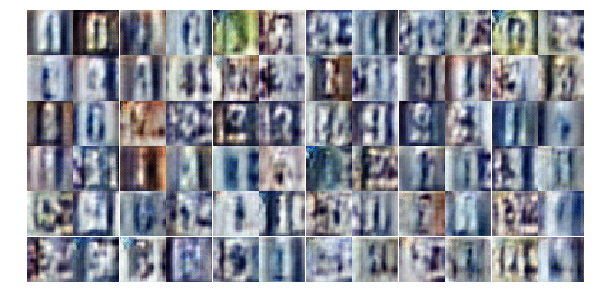

Epoch 6/20... Discriminator Loss: 1.2885... Generator Loss: 0.7438
Epoch 6/20... Discriminator Loss: 1.3362... Generator Loss: 0.7664
Epoch 6/20... Discriminator Loss: 1.3394... Generator Loss: 0.7218
Epoch 6/20... Discriminator Loss: 1.3681... Generator Loss: 0.7921
Epoch 6/20... Discriminator Loss: 1.3023... Generator Loss: 0.7655
Epoch 6/20... Discriminator Loss: 1.3402... Generator Loss: 0.6952
Epoch 6/20... Discriminator Loss: 1.3244... Generator Loss: 0.7199
Epoch 6/20... Discriminator Loss: 1.2939... Generator Loss: 0.7683
Epoch 6/20... Discriminator Loss: 1.3676... Generator Loss: 0.7186
Epoch 6/20... Discriminator Loss: 1.3353... Generator Loss: 0.7638


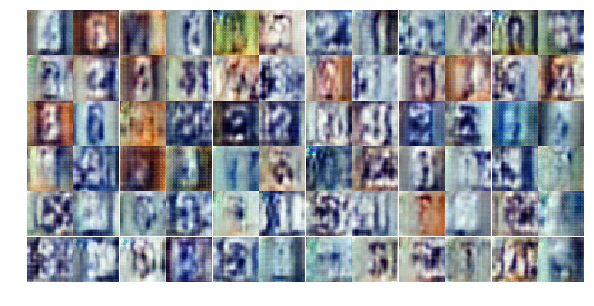

Epoch 6/20... Discriminator Loss: 1.3268... Generator Loss: 0.7051
Epoch 6/20... Discriminator Loss: 1.3534... Generator Loss: 0.7695
Epoch 6/20... Discriminator Loss: 1.3131... Generator Loss: 0.7509
Epoch 6/20... Discriminator Loss: 1.3457... Generator Loss: 0.7541
Epoch 6/20... Discriminator Loss: 1.3626... Generator Loss: 0.8155
Epoch 6/20... Discriminator Loss: 1.3235... Generator Loss: 0.7224
Epoch 6/20... Discriminator Loss: 1.3107... Generator Loss: 0.7200
Epoch 6/20... Discriminator Loss: 1.3387... Generator Loss: 0.7396
Epoch 6/20... Discriminator Loss: 1.3790... Generator Loss: 0.7176
Epoch 6/20... Discriminator Loss: 1.2801... Generator Loss: 0.6897


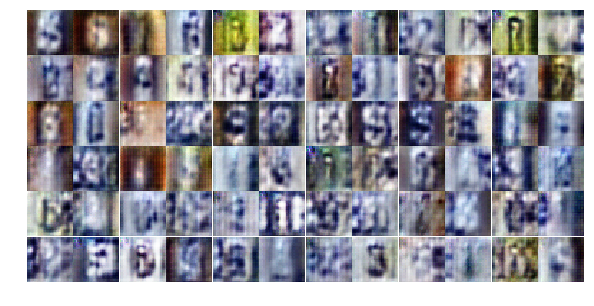

Epoch 6/20... Discriminator Loss: 1.3366... Generator Loss: 0.7002
Epoch 6/20... Discriminator Loss: 1.2893... Generator Loss: 0.6748
Epoch 6/20... Discriminator Loss: 1.3572... Generator Loss: 0.7912
Epoch 6/20... Discriminator Loss: 1.3519... Generator Loss: 0.6385
Epoch 6/20... Discriminator Loss: 1.4282... Generator Loss: 0.8974
Epoch 6/20... Discriminator Loss: 1.3915... Generator Loss: 0.6831
Epoch 6/20... Discriminator Loss: 1.3611... Generator Loss: 0.6972
Epoch 6/20... Discriminator Loss: 1.3524... Generator Loss: 0.6844
Epoch 6/20... Discriminator Loss: 1.4132... Generator Loss: 0.6713
Epoch 6/20... Discriminator Loss: 1.3856... Generator Loss: 0.6971


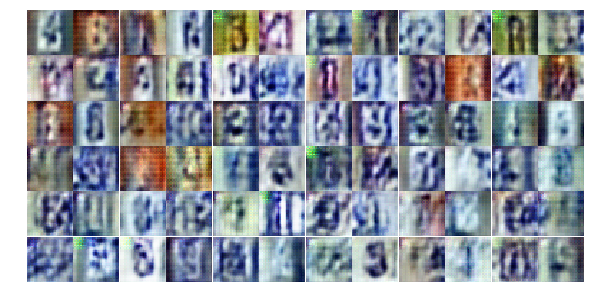

Epoch 6/20... Discriminator Loss: 1.3900... Generator Loss: 0.7031
Epoch 6/20... Discriminator Loss: 1.3930... Generator Loss: 0.6933
Epoch 6/20... Discriminator Loss: 1.3867... Generator Loss: 0.6859
Epoch 7/20... Discriminator Loss: 1.3865... Generator Loss: 0.6984
Epoch 7/20... Discriminator Loss: 1.3815... Generator Loss: 0.7022
Epoch 7/20... Discriminator Loss: 1.3969... Generator Loss: 0.6872
Epoch 7/20... Discriminator Loss: 1.3781... Generator Loss: 0.6994
Epoch 7/20... Discriminator Loss: 1.3739... Generator Loss: 0.6978
Epoch 7/20... Discriminator Loss: 1.3848... Generator Loss: 0.7019
Epoch 7/20... Discriminator Loss: 1.3703... Generator Loss: 0.6977


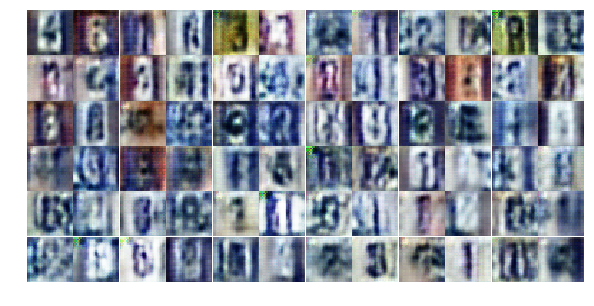

Epoch 7/20... Discriminator Loss: 1.3802... Generator Loss: 0.7072
Epoch 7/20... Discriminator Loss: 1.3906... Generator Loss: 0.7043
Epoch 7/20... Discriminator Loss: 1.3822... Generator Loss: 0.7015
Epoch 7/20... Discriminator Loss: 1.3788... Generator Loss: 0.6915
Epoch 7/20... Discriminator Loss: 1.3865... Generator Loss: 0.6942
Epoch 7/20... Discriminator Loss: 1.4385... Generator Loss: 0.7495
Epoch 7/20... Discriminator Loss: 1.3995... Generator Loss: 0.6972
Epoch 7/20... Discriminator Loss: 1.3741... Generator Loss: 0.7040
Epoch 7/20... Discriminator Loss: 1.3486... Generator Loss: 0.7114
Epoch 7/20... Discriminator Loss: 1.3882... Generator Loss: 0.7018


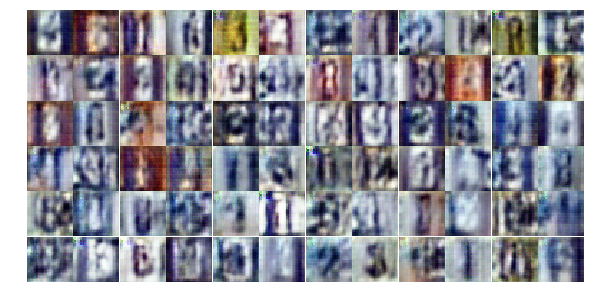

Epoch 7/20... Discriminator Loss: 1.3851... Generator Loss: 0.6944
Epoch 7/20... Discriminator Loss: 1.3767... Generator Loss: 0.7092
Epoch 7/20... Discriminator Loss: 1.3660... Generator Loss: 0.7017
Epoch 7/20... Discriminator Loss: 1.3802... Generator Loss: 0.6986
Epoch 7/20... Discriminator Loss: 1.3633... Generator Loss: 0.7040
Epoch 7/20... Discriminator Loss: 1.3674... Generator Loss: 0.7057
Epoch 7/20... Discriminator Loss: 1.3687... Generator Loss: 0.7059
Epoch 7/20... Discriminator Loss: 1.3761... Generator Loss: 0.7100
Epoch 7/20... Discriminator Loss: 1.3587... Generator Loss: 0.7048
Epoch 7/20... Discriminator Loss: 1.3641... Generator Loss: 0.7110


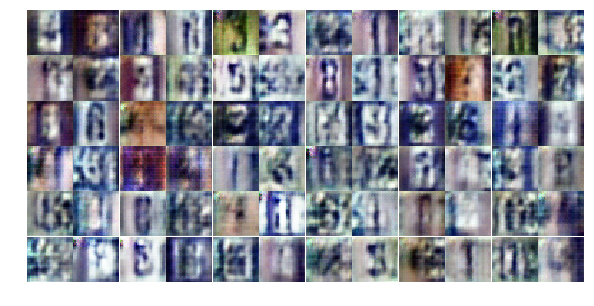

Epoch 7/20... Discriminator Loss: 1.3692... Generator Loss: 0.7129
Epoch 7/20... Discriminator Loss: 1.3624... Generator Loss: 0.7111
Epoch 7/20... Discriminator Loss: 1.3529... Generator Loss: 0.7146
Epoch 7/20... Discriminator Loss: 1.3691... Generator Loss: 0.7221
Epoch 7/20... Discriminator Loss: 1.3438... Generator Loss: 0.7154
Epoch 7/20... Discriminator Loss: 1.3724... Generator Loss: 0.6888
Epoch 7/20... Discriminator Loss: 1.3546... Generator Loss: 0.7140
Epoch 7/20... Discriminator Loss: 1.3748... Generator Loss: 0.7032
Epoch 7/20... Discriminator Loss: 1.3742... Generator Loss: 0.7205
Epoch 7/20... Discriminator Loss: 1.3691... Generator Loss: 0.7093


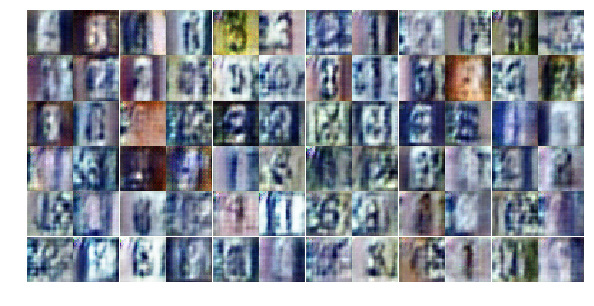

Epoch 7/20... Discriminator Loss: 1.3561... Generator Loss: 0.7153
Epoch 7/20... Discriminator Loss: 1.3666... Generator Loss: 0.7198
Epoch 7/20... Discriminator Loss: 1.3309... Generator Loss: 0.7082
Epoch 7/20... Discriminator Loss: 1.3554... Generator Loss: 0.7058
Epoch 7/20... Discriminator Loss: 1.3396... Generator Loss: 0.7100
Epoch 7/20... Discriminator Loss: 1.3355... Generator Loss: 0.7486
Epoch 7/20... Discriminator Loss: 1.3372... Generator Loss: 0.7216
Epoch 7/20... Discriminator Loss: 1.4377... Generator Loss: 0.7441
Epoch 7/20... Discriminator Loss: 1.3822... Generator Loss: 0.7259
Epoch 7/20... Discriminator Loss: 1.3611... Generator Loss: 0.7124


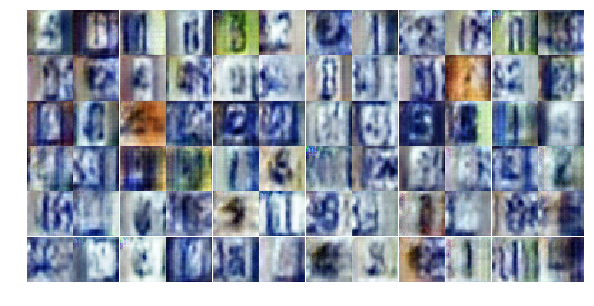

Epoch 7/20... Discriminator Loss: 1.3018... Generator Loss: 0.7075
Epoch 7/20... Discriminator Loss: 1.3892... Generator Loss: 0.7352
Epoch 7/20... Discriminator Loss: 1.3576... Generator Loss: 0.7237
Epoch 7/20... Discriminator Loss: 1.3329... Generator Loss: 0.7192
Epoch 7/20... Discriminator Loss: 1.3794... Generator Loss: 0.6734
Epoch 7/20... Discriminator Loss: 1.3760... Generator Loss: 0.6744
Epoch 7/20... Discriminator Loss: 1.3818... Generator Loss: 0.6704
Epoch 7/20... Discriminator Loss: 1.3310... Generator Loss: 0.7520
Epoch 7/20... Discriminator Loss: 1.3528... Generator Loss: 0.6883
Epoch 7/20... Discriminator Loss: 1.3298... Generator Loss: 0.7239


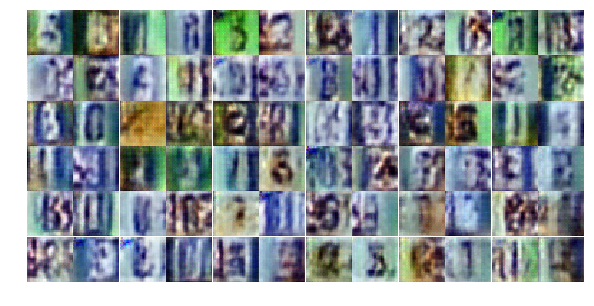

Epoch 7/20... Discriminator Loss: 1.3254... Generator Loss: 0.7101
Epoch 8/20... Discriminator Loss: 1.3552... Generator Loss: 0.7216
Epoch 8/20... Discriminator Loss: 1.3297... Generator Loss: 0.7086
Epoch 8/20... Discriminator Loss: 1.3349... Generator Loss: 0.7256
Epoch 8/20... Discriminator Loss: 1.3258... Generator Loss: 0.7182
Epoch 8/20... Discriminator Loss: 1.3689... Generator Loss: 0.6787
Epoch 8/20... Discriminator Loss: 1.3334... Generator Loss: 0.6975
Epoch 8/20... Discriminator Loss: 1.3378... Generator Loss: 0.7388
Epoch 8/20... Discriminator Loss: 1.3527... Generator Loss: 0.6974
Epoch 8/20... Discriminator Loss: 1.3065... Generator Loss: 0.6924


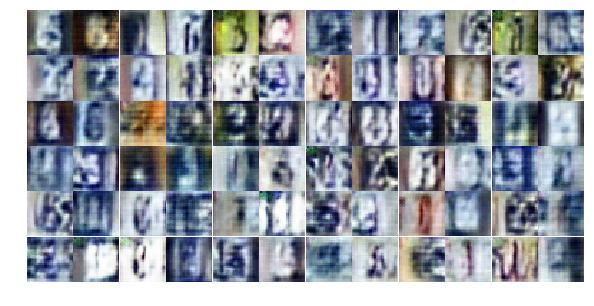

Epoch 8/20... Discriminator Loss: 1.3494... Generator Loss: 0.7184
Epoch 8/20... Discriminator Loss: 1.2655... Generator Loss: 0.7000
Epoch 8/20... Discriminator Loss: 1.3725... Generator Loss: 0.7044
Epoch 8/20... Discriminator Loss: 1.2886... Generator Loss: 0.7101
Epoch 8/20... Discriminator Loss: 1.3387... Generator Loss: 0.7136
Epoch 8/20... Discriminator Loss: 1.3581... Generator Loss: 0.7081
Epoch 8/20... Discriminator Loss: 1.3505... Generator Loss: 0.7078
Epoch 8/20... Discriminator Loss: 1.4258... Generator Loss: 0.7579
Epoch 8/20... Discriminator Loss: 1.3330... Generator Loss: 0.7155
Epoch 8/20... Discriminator Loss: 1.3779... Generator Loss: 0.6777


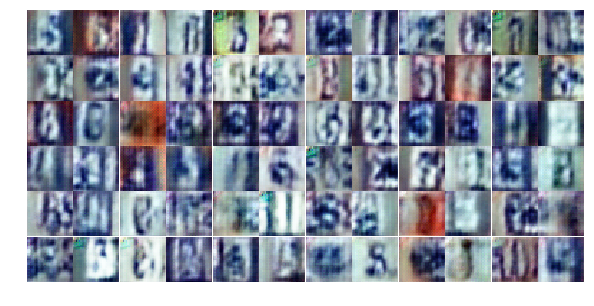

Epoch 8/20... Discriminator Loss: 1.3315... Generator Loss: 0.7007
Epoch 8/20... Discriminator Loss: 1.3015... Generator Loss: 0.6941
Epoch 8/20... Discriminator Loss: 1.3854... Generator Loss: 0.6858
Epoch 8/20... Discriminator Loss: 1.3578... Generator Loss: 0.7195
Epoch 8/20... Discriminator Loss: 1.3249... Generator Loss: 0.7362
Epoch 8/20... Discriminator Loss: 1.3580... Generator Loss: 0.6926
Epoch 8/20... Discriminator Loss: 1.4074... Generator Loss: 0.7496
Epoch 8/20... Discriminator Loss: 1.2932... Generator Loss: 0.6975
Epoch 8/20... Discriminator Loss: 1.3688... Generator Loss: 0.7185
Epoch 8/20... Discriminator Loss: 1.3463... Generator Loss: 0.7050


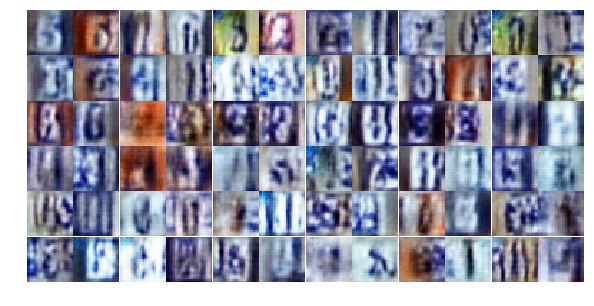

Epoch 8/20... Discriminator Loss: 1.3863... Generator Loss: 0.6967
Epoch 8/20... Discriminator Loss: 1.3724... Generator Loss: 0.6838
Epoch 8/20... Discriminator Loss: 1.3359... Generator Loss: 0.7321
Epoch 8/20... Discriminator Loss: 1.3107... Generator Loss: 0.6884
Epoch 8/20... Discriminator Loss: 1.3874... Generator Loss: 0.6910
Epoch 8/20... Discriminator Loss: 1.3539... Generator Loss: 0.7552
Epoch 8/20... Discriminator Loss: 1.3521... Generator Loss: 0.7194
Epoch 8/20... Discriminator Loss: 1.3443... Generator Loss: 0.7243
Epoch 8/20... Discriminator Loss: 1.3566... Generator Loss: 0.6842
Epoch 8/20... Discriminator Loss: 1.3117... Generator Loss: 0.7143


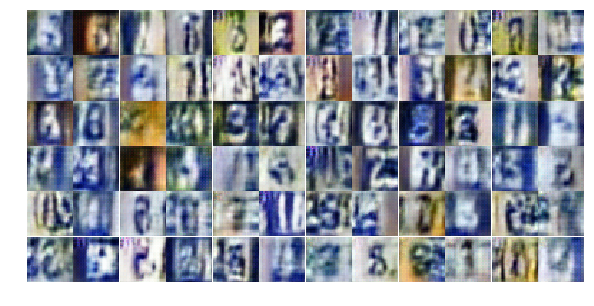

Epoch 8/20... Discriminator Loss: 1.3754... Generator Loss: 0.7387
Epoch 8/20... Discriminator Loss: 1.3470... Generator Loss: 0.7071
Epoch 8/20... Discriminator Loss: 1.3430... Generator Loss: 0.7330
Epoch 8/20... Discriminator Loss: 1.3327... Generator Loss: 0.7150
Epoch 8/20... Discriminator Loss: 1.3565... Generator Loss: 0.7028
Epoch 8/20... Discriminator Loss: 1.4046... Generator Loss: 0.7015
Epoch 8/20... Discriminator Loss: 1.3641... Generator Loss: 0.7205
Epoch 8/20... Discriminator Loss: 1.3721... Generator Loss: 0.7083
Epoch 8/20... Discriminator Loss: 1.3172... Generator Loss: 0.7720
Epoch 8/20... Discriminator Loss: 1.3261... Generator Loss: 0.7454


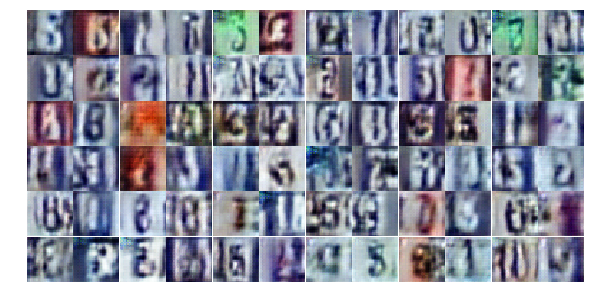

Epoch 8/20... Discriminator Loss: 1.3113... Generator Loss: 0.6642
Epoch 8/20... Discriminator Loss: 1.3342... Generator Loss: 0.7227
Epoch 8/20... Discriminator Loss: 1.3418... Generator Loss: 0.7107
Epoch 8/20... Discriminator Loss: 1.3552... Generator Loss: 0.7226
Epoch 8/20... Discriminator Loss: 1.3607... Generator Loss: 0.7448
Epoch 8/20... Discriminator Loss: 1.3970... Generator Loss: 0.7024
Epoch 8/20... Discriminator Loss: 1.3604... Generator Loss: 0.7151
Epoch 8/20... Discriminator Loss: 1.3607... Generator Loss: 0.7146
Epoch 9/20... Discriminator Loss: 1.3790... Generator Loss: 0.7093
Epoch 9/20... Discriminator Loss: 1.3808... Generator Loss: 0.7335


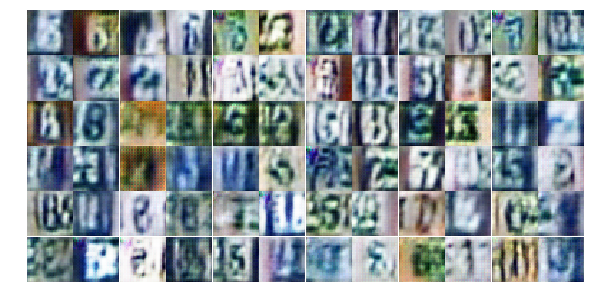

Epoch 9/20... Discriminator Loss: 1.3633... Generator Loss: 0.6989
Epoch 9/20... Discriminator Loss: 1.3581... Generator Loss: 0.7674
Epoch 9/20... Discriminator Loss: 1.3683... Generator Loss: 0.7075
Epoch 9/20... Discriminator Loss: 1.3143... Generator Loss: 0.7094
Epoch 9/20... Discriminator Loss: 1.4029... Generator Loss: 0.7063
Epoch 9/20... Discriminator Loss: 1.2320... Generator Loss: 0.7304
Epoch 9/20... Discriminator Loss: 1.4180... Generator Loss: 0.7264
Epoch 9/20... Discriminator Loss: 1.3507... Generator Loss: 0.7058
Epoch 9/20... Discriminator Loss: 1.3105... Generator Loss: 0.7026
Epoch 9/20... Discriminator Loss: 1.3697... Generator Loss: 0.7578


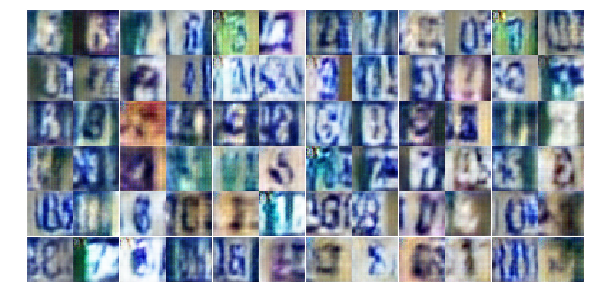

Epoch 9/20... Discriminator Loss: 1.2763... Generator Loss: 0.7167
Epoch 9/20... Discriminator Loss: 1.3370... Generator Loss: 0.6200
Epoch 9/20... Discriminator Loss: 1.3994... Generator Loss: 0.5937
Epoch 9/20... Discriminator Loss: 1.4620... Generator Loss: 0.6813
Epoch 9/20... Discriminator Loss: 1.3188... Generator Loss: 0.6942
Epoch 9/20... Discriminator Loss: 1.3384... Generator Loss: 0.7412
Epoch 9/20... Discriminator Loss: 1.3703... Generator Loss: 0.7227
Epoch 9/20... Discriminator Loss: 1.3299... Generator Loss: 0.7172
Epoch 9/20... Discriminator Loss: 1.4055... Generator Loss: 0.6870
Epoch 9/20... Discriminator Loss: 1.3900... Generator Loss: 0.7069


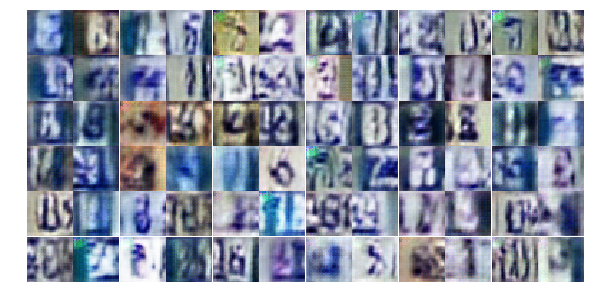

Epoch 9/20... Discriminator Loss: 1.3439... Generator Loss: 0.6771
Epoch 9/20... Discriminator Loss: 1.3564... Generator Loss: 0.7030
Epoch 9/20... Discriminator Loss: 1.3723... Generator Loss: 0.6997
Epoch 9/20... Discriminator Loss: 1.2719... Generator Loss: 0.7624
Epoch 9/20... Discriminator Loss: 1.3247... Generator Loss: 0.6890
Epoch 9/20... Discriminator Loss: 1.3238... Generator Loss: 0.7169
Epoch 9/20... Discriminator Loss: 1.3642... Generator Loss: 0.7306
Epoch 9/20... Discriminator Loss: 1.3794... Generator Loss: 0.6641
Epoch 9/20... Discriminator Loss: 1.3365... Generator Loss: 0.7838
Epoch 9/20... Discriminator Loss: 1.4279... Generator Loss: 0.6659


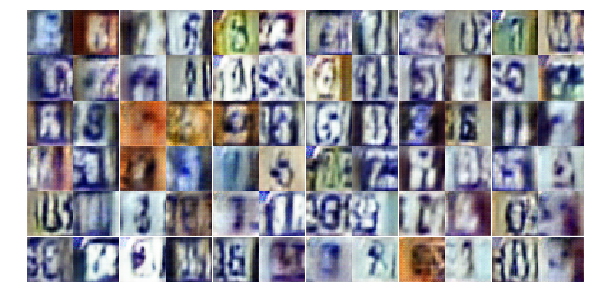

Epoch 9/20... Discriminator Loss: 1.3589... Generator Loss: 0.7361
Epoch 9/20... Discriminator Loss: 1.4562... Generator Loss: 0.6352
Epoch 9/20... Discriminator Loss: 1.3713... Generator Loss: 0.6981
Epoch 9/20... Discriminator Loss: 1.3220... Generator Loss: 0.7459
Epoch 9/20... Discriminator Loss: 1.2984... Generator Loss: 0.7904
Epoch 9/20... Discriminator Loss: 1.3669... Generator Loss: 0.6542
Epoch 9/20... Discriminator Loss: 1.4598... Generator Loss: 0.6903
Epoch 9/20... Discriminator Loss: 1.3563... Generator Loss: 0.7218
Epoch 9/20... Discriminator Loss: 1.3433... Generator Loss: 0.7338
Epoch 9/20... Discriminator Loss: 1.3627... Generator Loss: 0.7068


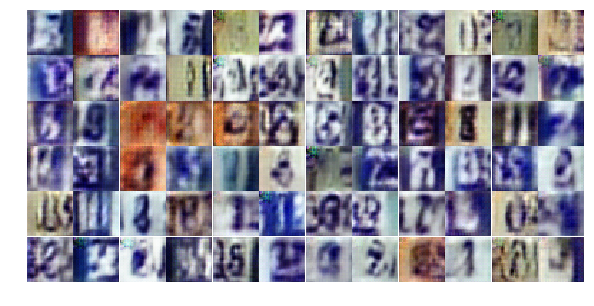

Epoch 9/20... Discriminator Loss: 1.3566... Generator Loss: 0.7471
Epoch 9/20... Discriminator Loss: 1.3346... Generator Loss: 0.6531
Epoch 9/20... Discriminator Loss: 1.3685... Generator Loss: 0.7056
Epoch 9/20... Discriminator Loss: 1.3459... Generator Loss: 0.7440
Epoch 9/20... Discriminator Loss: 1.3102... Generator Loss: 0.6998
Epoch 9/20... Discriminator Loss: 1.3394... Generator Loss: 0.6861
Epoch 9/20... Discriminator Loss: 1.3540... Generator Loss: 0.7327
Epoch 9/20... Discriminator Loss: 1.3659... Generator Loss: 0.6956
Epoch 9/20... Discriminator Loss: 1.3377... Generator Loss: 0.7268
Epoch 9/20... Discriminator Loss: 1.3303... Generator Loss: 0.6753


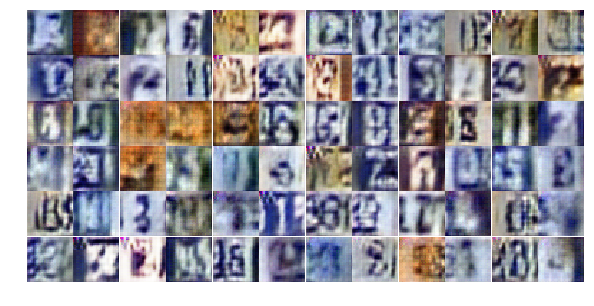

Epoch 9/20... Discriminator Loss: 1.3770... Generator Loss: 0.7245
Epoch 9/20... Discriminator Loss: 1.3968... Generator Loss: 0.6510
Epoch 9/20... Discriminator Loss: 1.3384... Generator Loss: 0.7040
Epoch 9/20... Discriminator Loss: 1.3293... Generator Loss: 0.7224
Epoch 9/20... Discriminator Loss: 1.3240... Generator Loss: 0.7387
Epoch 10/20... Discriminator Loss: 1.3225... Generator Loss: 0.7128
Epoch 10/20... Discriminator Loss: 1.3639... Generator Loss: 0.6907
Epoch 10/20... Discriminator Loss: 1.4102... Generator Loss: 0.6911
Epoch 10/20... Discriminator Loss: 1.4324... Generator Loss: 0.6873
Epoch 10/20... Discriminator Loss: 1.4114... Generator Loss: 0.6679


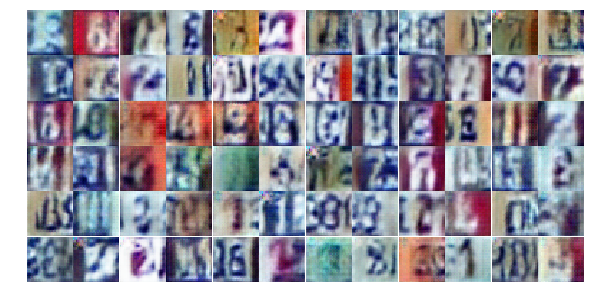

Epoch 10/20... Discriminator Loss: 1.3365... Generator Loss: 0.7090
Epoch 10/20... Discriminator Loss: 1.3600... Generator Loss: 0.7095
Epoch 10/20... Discriminator Loss: 1.3337... Generator Loss: 0.7245
Epoch 10/20... Discriminator Loss: 1.3265... Generator Loss: 0.7066
Epoch 10/20... Discriminator Loss: 1.3540... Generator Loss: 0.6895
Epoch 10/20... Discriminator Loss: 1.2996... Generator Loss: 0.7550
Epoch 10/20... Discriminator Loss: 1.3313... Generator Loss: 0.7329
Epoch 10/20... Discriminator Loss: 1.3686... Generator Loss: 0.7083
Epoch 10/20... Discriminator Loss: 1.3379... Generator Loss: 0.7090
Epoch 10/20... Discriminator Loss: 1.3428... Generator Loss: 0.7169


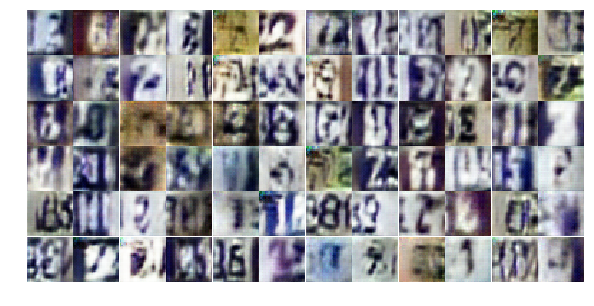

Epoch 10/20... Discriminator Loss: 1.3606... Generator Loss: 0.7322
Epoch 10/20... Discriminator Loss: 1.3687... Generator Loss: 0.6840
Epoch 10/20... Discriminator Loss: 1.3111... Generator Loss: 0.7353
Epoch 10/20... Discriminator Loss: 1.3198... Generator Loss: 0.7525
Epoch 10/20... Discriminator Loss: 1.3675... Generator Loss: 0.7108
Epoch 10/20... Discriminator Loss: 1.3383... Generator Loss: 0.7243
Epoch 10/20... Discriminator Loss: 1.3569... Generator Loss: 0.6957
Epoch 10/20... Discriminator Loss: 1.3034... Generator Loss: 0.7146
Epoch 10/20... Discriminator Loss: 1.3992... Generator Loss: 0.6984
Epoch 10/20... Discriminator Loss: 1.3221... Generator Loss: 0.6666


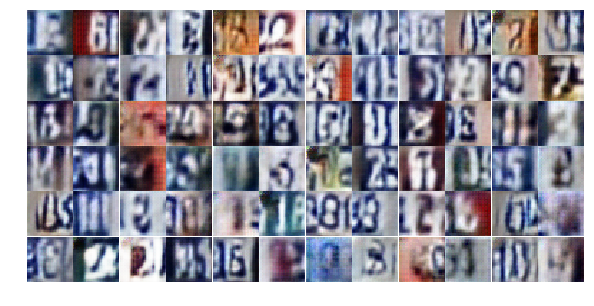

Epoch 10/20... Discriminator Loss: 1.3594... Generator Loss: 0.7340
Epoch 10/20... Discriminator Loss: 1.3073... Generator Loss: 0.6989
Epoch 10/20... Discriminator Loss: 1.3240... Generator Loss: 0.7340
Epoch 10/20... Discriminator Loss: 1.3727... Generator Loss: 0.6670
Epoch 10/20... Discriminator Loss: 1.3543... Generator Loss: 0.6961
Epoch 10/20... Discriminator Loss: 1.4099... Generator Loss: 0.7193
Epoch 10/20... Discriminator Loss: 1.3246... Generator Loss: 0.7232
Epoch 10/20... Discriminator Loss: 1.3056... Generator Loss: 0.7197
Epoch 10/20... Discriminator Loss: 1.3419... Generator Loss: 0.6783
Epoch 10/20... Discriminator Loss: 1.3290... Generator Loss: 0.6986


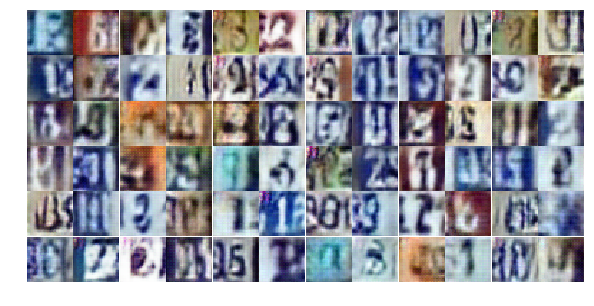

Epoch 10/20... Discriminator Loss: 1.3719... Generator Loss: 0.7023
Epoch 10/20... Discriminator Loss: 1.3364... Generator Loss: 0.7574
Epoch 10/20... Discriminator Loss: 1.3192... Generator Loss: 0.6981
Epoch 10/20... Discriminator Loss: 1.3492... Generator Loss: 0.6959
Epoch 10/20... Discriminator Loss: 1.2937... Generator Loss: 0.7565
Epoch 10/20... Discriminator Loss: 1.3176... Generator Loss: 0.7009
Epoch 10/20... Discriminator Loss: 1.3977... Generator Loss: 0.6919
Epoch 10/20... Discriminator Loss: 1.3296... Generator Loss: 0.7457
Epoch 10/20... Discriminator Loss: 1.4008... Generator Loss: 0.6564
Epoch 10/20... Discriminator Loss: 1.3703... Generator Loss: 0.6836


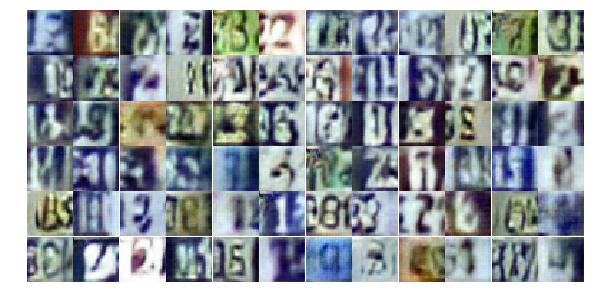

Epoch 10/20... Discriminator Loss: 1.3141... Generator Loss: 0.7446
Epoch 10/20... Discriminator Loss: 1.3462... Generator Loss: 0.7095
Epoch 10/20... Discriminator Loss: 1.4252... Generator Loss: 0.6773
Epoch 10/20... Discriminator Loss: 1.2185... Generator Loss: 0.8310
Epoch 10/20... Discriminator Loss: 1.3431... Generator Loss: 0.8080
Epoch 10/20... Discriminator Loss: 1.3655... Generator Loss: 0.7049
Epoch 10/20... Discriminator Loss: 1.3148... Generator Loss: 0.7338
Epoch 10/20... Discriminator Loss: 1.3091... Generator Loss: 0.7524
Epoch 10/20... Discriminator Loss: 1.3103... Generator Loss: 0.7461
Epoch 10/20... Discriminator Loss: 1.3756... Generator Loss: 0.6931


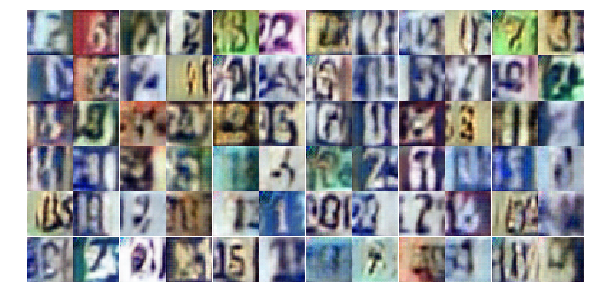

Epoch 10/20... Discriminator Loss: 1.3562... Generator Loss: 0.6967
Epoch 10/20... Discriminator Loss: 1.2990... Generator Loss: 0.7384
Epoch 10/20... Discriminator Loss: 1.2720... Generator Loss: 0.7999
Epoch 11/20... Discriminator Loss: 1.2728... Generator Loss: 0.6978
Epoch 11/20... Discriminator Loss: 1.3370... Generator Loss: 0.7955
Epoch 11/20... Discriminator Loss: 1.3573... Generator Loss: 0.6924
Epoch 11/20... Discriminator Loss: 1.3535... Generator Loss: 0.7412
Epoch 11/20... Discriminator Loss: 1.3520... Generator Loss: 0.7153
Epoch 11/20... Discriminator Loss: 1.3604... Generator Loss: 0.6630
Epoch 11/20... Discriminator Loss: 1.3639... Generator Loss: 0.7108


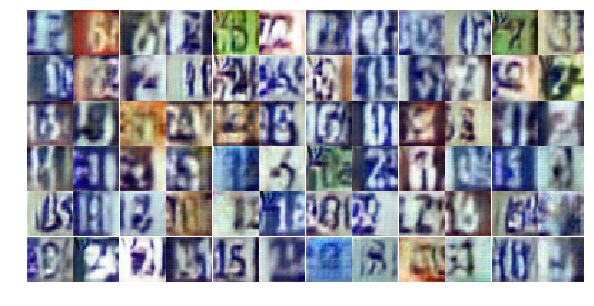

Epoch 11/20... Discriminator Loss: 1.3507... Generator Loss: 0.7050
Epoch 11/20... Discriminator Loss: 1.3594... Generator Loss: 0.7366
Epoch 11/20... Discriminator Loss: 1.2669... Generator Loss: 0.7215
Epoch 11/20... Discriminator Loss: 1.3780... Generator Loss: 0.7059
Epoch 11/20... Discriminator Loss: 1.3249... Generator Loss: 0.7055
Epoch 11/20... Discriminator Loss: 1.3269... Generator Loss: 0.7741
Epoch 11/20... Discriminator Loss: 1.3621... Generator Loss: 0.7087
Epoch 11/20... Discriminator Loss: 1.3028... Generator Loss: 0.7668
Epoch 11/20... Discriminator Loss: 1.3993... Generator Loss: 0.6760
Epoch 11/20... Discriminator Loss: 1.3368... Generator Loss: 0.6830


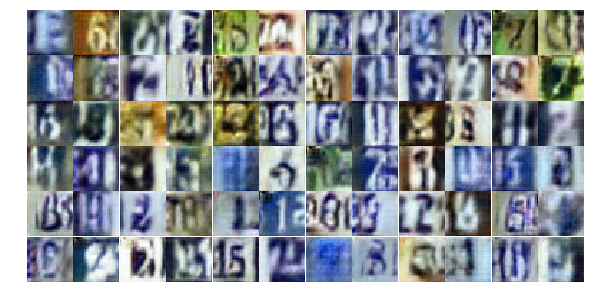

Epoch 11/20... Discriminator Loss: 1.3157... Generator Loss: 0.7061
Epoch 11/20... Discriminator Loss: 1.4020... Generator Loss: 0.6682
Epoch 11/20... Discriminator Loss: 1.3466... Generator Loss: 0.7197
Epoch 11/20... Discriminator Loss: 1.3876... Generator Loss: 0.6979
Epoch 11/20... Discriminator Loss: 1.3428... Generator Loss: 0.6938
Epoch 11/20... Discriminator Loss: 1.1785... Generator Loss: 0.8096
Epoch 11/20... Discriminator Loss: 1.2558... Generator Loss: 0.7456
Epoch 11/20... Discriminator Loss: 1.4177... Generator Loss: 0.6760
Epoch 11/20... Discriminator Loss: 1.3472... Generator Loss: 0.7114
Epoch 11/20... Discriminator Loss: 1.4142... Generator Loss: 0.7229


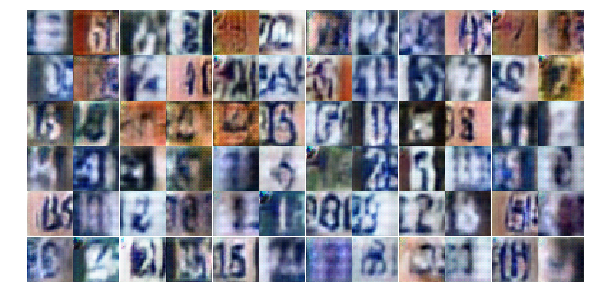

Epoch 11/20... Discriminator Loss: 1.3521... Generator Loss: 0.7336
Epoch 11/20... Discriminator Loss: 1.3447... Generator Loss: 0.7232
Epoch 11/20... Discriminator Loss: 1.3585... Generator Loss: 0.7161
Epoch 11/20... Discriminator Loss: 1.3069... Generator Loss: 0.7129
Epoch 11/20... Discriminator Loss: 1.4386... Generator Loss: 0.6773
Epoch 11/20... Discriminator Loss: 1.2819... Generator Loss: 0.7039
Epoch 11/20... Discriminator Loss: 1.3358... Generator Loss: 0.7522
Epoch 11/20... Discriminator Loss: 1.3764... Generator Loss: 0.6988
Epoch 11/20... Discriminator Loss: 1.2942... Generator Loss: 0.7509
Epoch 11/20... Discriminator Loss: 1.3734... Generator Loss: 0.6896


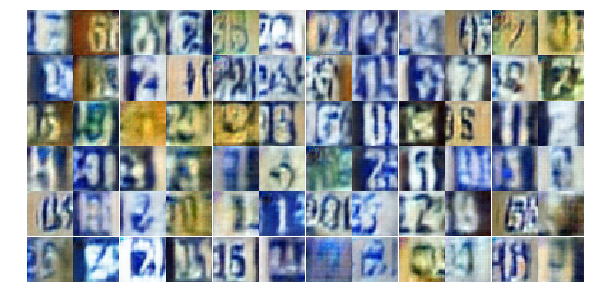

Epoch 11/20... Discriminator Loss: 1.3420... Generator Loss: 0.7425
Epoch 11/20... Discriminator Loss: 1.3051... Generator Loss: 0.7102
Epoch 11/20... Discriminator Loss: 1.3647... Generator Loss: 0.6866
Epoch 11/20... Discriminator Loss: 1.3025... Generator Loss: 0.7644
Epoch 11/20... Discriminator Loss: 1.3566... Generator Loss: 0.6693
Epoch 11/20... Discriminator Loss: 1.2668... Generator Loss: 0.7452
Epoch 11/20... Discriminator Loss: 1.3415... Generator Loss: 0.7220
Epoch 11/20... Discriminator Loss: 1.3839... Generator Loss: 0.7138
Epoch 11/20... Discriminator Loss: 1.3060... Generator Loss: 0.7717
Epoch 11/20... Discriminator Loss: 1.2076... Generator Loss: 0.7309


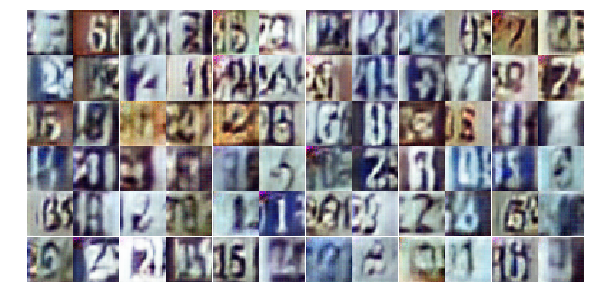

Epoch 11/20... Discriminator Loss: 1.2962... Generator Loss: 0.7419
Epoch 11/20... Discriminator Loss: 1.3306... Generator Loss: 0.7178
Epoch 11/20... Discriminator Loss: 1.4172... Generator Loss: 0.6459
Epoch 11/20... Discriminator Loss: 1.3536... Generator Loss: 0.7471
Epoch 11/20... Discriminator Loss: 1.3536... Generator Loss: 0.7458
Epoch 11/20... Discriminator Loss: 1.3325... Generator Loss: 0.6890
Epoch 11/20... Discriminator Loss: 1.3677... Generator Loss: 0.7226
Epoch 11/20... Discriminator Loss: 1.3149... Generator Loss: 0.7972
Epoch 11/20... Discriminator Loss: 1.2935... Generator Loss: 0.6911
Epoch 11/20... Discriminator Loss: 1.3596... Generator Loss: 0.7213


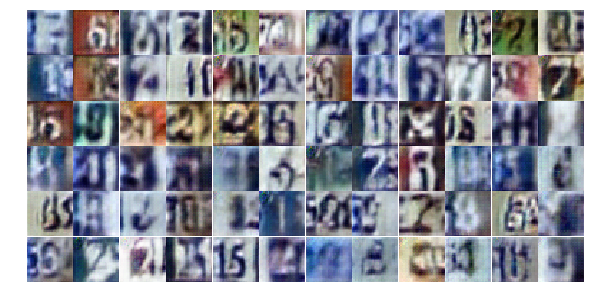

Epoch 12/20... Discriminator Loss: 1.3315... Generator Loss: 0.7157
Epoch 12/20... Discriminator Loss: 1.3570... Generator Loss: 0.6951
Epoch 12/20... Discriminator Loss: 1.3453... Generator Loss: 0.6713
Epoch 12/20... Discriminator Loss: 1.3173... Generator Loss: 0.7396
Epoch 12/20... Discriminator Loss: 1.3268... Generator Loss: 0.7369
Epoch 12/20... Discriminator Loss: 1.3756... Generator Loss: 0.7268
Epoch 12/20... Discriminator Loss: 1.3968... Generator Loss: 0.6633
Epoch 12/20... Discriminator Loss: 1.3712... Generator Loss: 0.6806
Epoch 12/20... Discriminator Loss: 1.3414... Generator Loss: 0.7193
Epoch 12/20... Discriminator Loss: 1.3885... Generator Loss: 0.7069


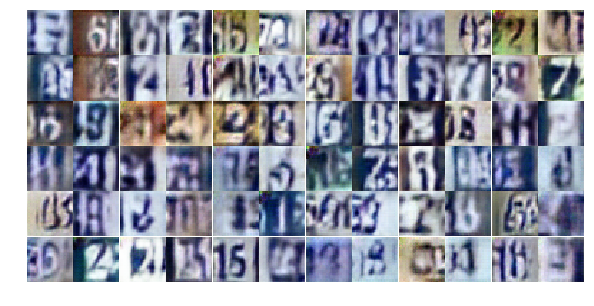

Epoch 12/20... Discriminator Loss: 1.3390... Generator Loss: 0.7220
Epoch 12/20... Discriminator Loss: 1.3280... Generator Loss: 0.6847
Epoch 12/20... Discriminator Loss: 1.3229... Generator Loss: 0.6898
Epoch 12/20... Discriminator Loss: 1.3320... Generator Loss: 0.7220
Epoch 12/20... Discriminator Loss: 1.3682... Generator Loss: 0.6904
Epoch 12/20... Discriminator Loss: 1.3834... Generator Loss: 0.7019
Epoch 12/20... Discriminator Loss: 1.3666... Generator Loss: 0.6970
Epoch 12/20... Discriminator Loss: 1.3368... Generator Loss: 0.7092
Epoch 12/20... Discriminator Loss: 1.3294... Generator Loss: 0.8047
Epoch 12/20... Discriminator Loss: 1.2884... Generator Loss: 0.7303


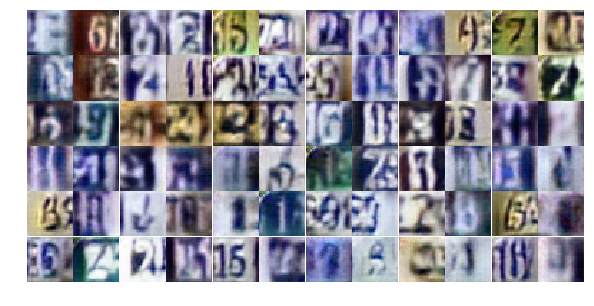

Epoch 12/20... Discriminator Loss: 1.2712... Generator Loss: 0.7677
Epoch 12/20... Discriminator Loss: 1.4910... Generator Loss: 0.6318
Epoch 12/20... Discriminator Loss: 1.3113... Generator Loss: 0.7046
Epoch 12/20... Discriminator Loss: 1.2745... Generator Loss: 0.6987
Epoch 12/20... Discriminator Loss: 1.3686... Generator Loss: 0.6943
Epoch 12/20... Discriminator Loss: 1.3146... Generator Loss: 0.7034
Epoch 12/20... Discriminator Loss: 1.2995... Generator Loss: 0.7338
Epoch 12/20... Discriminator Loss: 1.3531... Generator Loss: 0.7569
Epoch 12/20... Discriminator Loss: 1.3222... Generator Loss: 0.7665
Epoch 12/20... Discriminator Loss: 1.3845... Generator Loss: 0.6493


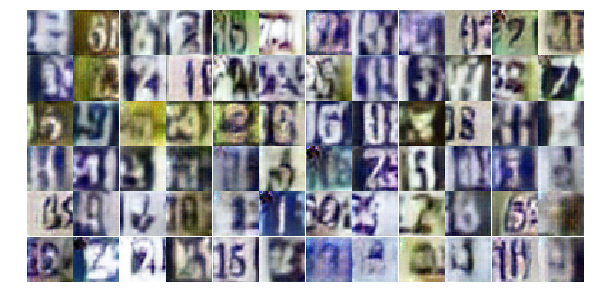

Epoch 12/20... Discriminator Loss: 1.3582... Generator Loss: 0.6793
Epoch 12/20... Discriminator Loss: 1.3476... Generator Loss: 0.7544
Epoch 12/20... Discriminator Loss: 1.3738... Generator Loss: 0.6586
Epoch 12/20... Discriminator Loss: 1.4053... Generator Loss: 0.7966
Epoch 12/20... Discriminator Loss: 1.3016... Generator Loss: 0.6902
Epoch 12/20... Discriminator Loss: 1.3829... Generator Loss: 0.6949
Epoch 12/20... Discriminator Loss: 1.3684... Generator Loss: 0.7131
Epoch 12/20... Discriminator Loss: 1.3459... Generator Loss: 0.6970
Epoch 12/20... Discriminator Loss: 1.3712... Generator Loss: 0.7084
Epoch 12/20... Discriminator Loss: 1.2251... Generator Loss: 0.7174


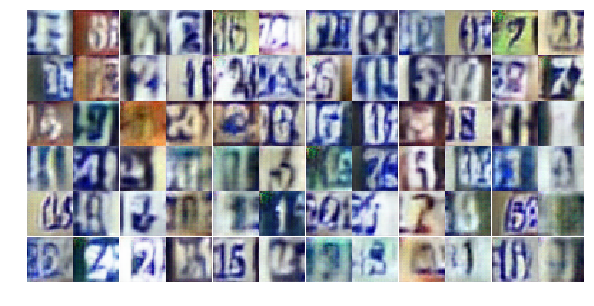

Epoch 12/20... Discriminator Loss: 1.4188... Generator Loss: 0.6870
Epoch 12/20... Discriminator Loss: 1.2640... Generator Loss: 0.7123
Epoch 12/20... Discriminator Loss: 1.3563... Generator Loss: 0.7307
Epoch 12/20... Discriminator Loss: 1.4437... Generator Loss: 0.6079
Epoch 12/20... Discriminator Loss: 1.4235... Generator Loss: 0.6943
Epoch 12/20... Discriminator Loss: 1.2928... Generator Loss: 0.6728
Epoch 12/20... Discriminator Loss: 1.3434... Generator Loss: 0.6889
Epoch 12/20... Discriminator Loss: 1.3322... Generator Loss: 0.7202
Epoch 12/20... Discriminator Loss: 1.4248... Generator Loss: 0.6625
Epoch 12/20... Discriminator Loss: 1.3227... Generator Loss: 0.6710


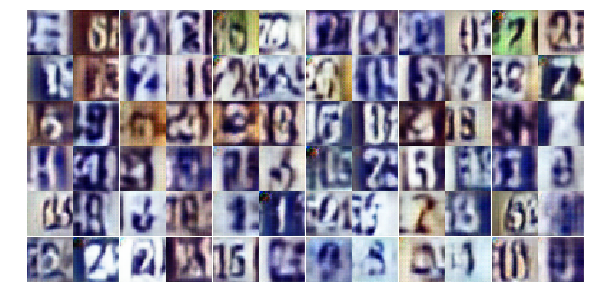

Epoch 12/20... Discriminator Loss: 1.3864... Generator Loss: 0.6775
Epoch 12/20... Discriminator Loss: 1.3316... Generator Loss: 0.6875
Epoch 12/20... Discriminator Loss: 1.2380... Generator Loss: 0.7469
Epoch 12/20... Discriminator Loss: 1.4074... Generator Loss: 0.6012
Epoch 12/20... Discriminator Loss: 1.2978... Generator Loss: 0.7219
Epoch 12/20... Discriminator Loss: 1.3506... Generator Loss: 0.6761
Epoch 12/20... Discriminator Loss: 1.3427... Generator Loss: 0.7054
Epoch 13/20... Discriminator Loss: 1.3629... Generator Loss: 0.7255
Epoch 13/20... Discriminator Loss: 1.3316... Generator Loss: 0.6862
Epoch 13/20... Discriminator Loss: 1.3279... Generator Loss: 0.7354


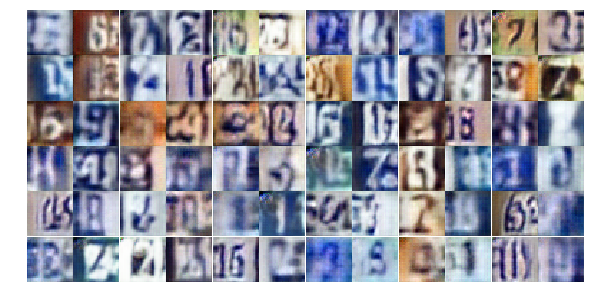

Epoch 13/20... Discriminator Loss: 1.4242... Generator Loss: 0.6385
Epoch 13/20... Discriminator Loss: 1.3170... Generator Loss: 0.7102
Epoch 13/20... Discriminator Loss: 1.3544... Generator Loss: 0.7053
Epoch 13/20... Discriminator Loss: 1.3431... Generator Loss: 0.7536
Epoch 13/20... Discriminator Loss: 1.3838... Generator Loss: 0.6902
Epoch 13/20... Discriminator Loss: 1.3157... Generator Loss: 0.7292
Epoch 13/20... Discriminator Loss: 1.3280... Generator Loss: 0.7991
Epoch 13/20... Discriminator Loss: 1.3423... Generator Loss: 0.6821
Epoch 13/20... Discriminator Loss: 1.3968... Generator Loss: 0.7074
Epoch 13/20... Discriminator Loss: 1.3805... Generator Loss: 0.7532


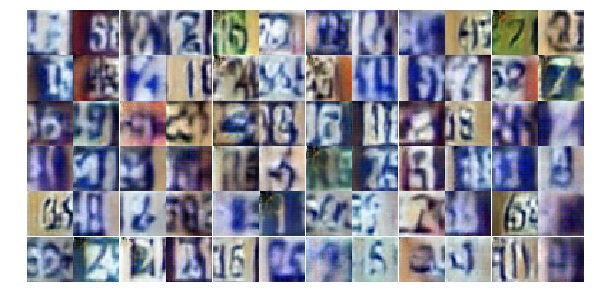

Epoch 13/20... Discriminator Loss: 1.3393... Generator Loss: 0.6905
Epoch 13/20... Discriminator Loss: 1.3006... Generator Loss: 0.7600
Epoch 13/20... Discriminator Loss: 1.3044... Generator Loss: 0.7791
Epoch 13/20... Discriminator Loss: 1.3527... Generator Loss: 0.7012
Epoch 13/20... Discriminator Loss: 1.3327... Generator Loss: 0.7353
Epoch 13/20... Discriminator Loss: 1.3102... Generator Loss: 0.7242
Epoch 13/20... Discriminator Loss: 1.2393... Generator Loss: 0.7219
Epoch 13/20... Discriminator Loss: 1.3089... Generator Loss: 0.7045
Epoch 13/20... Discriminator Loss: 1.3749... Generator Loss: 0.6577
Epoch 13/20... Discriminator Loss: 1.3531... Generator Loss: 0.6985


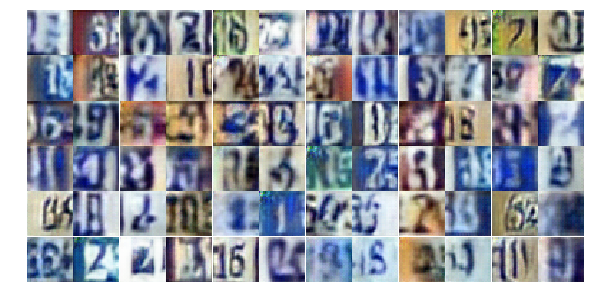

Epoch 13/20... Discriminator Loss: 1.3901... Generator Loss: 0.7004
Epoch 13/20... Discriminator Loss: 1.3293... Generator Loss: 0.7021
Epoch 13/20... Discriminator Loss: 1.3510... Generator Loss: 0.7012
Epoch 13/20... Discriminator Loss: 1.3956... Generator Loss: 0.6819
Epoch 13/20... Discriminator Loss: 1.3899... Generator Loss: 0.7018
Epoch 13/20... Discriminator Loss: 1.4321... Generator Loss: 0.6111
Epoch 13/20... Discriminator Loss: 1.2897... Generator Loss: 0.6770
Epoch 13/20... Discriminator Loss: 1.2827... Generator Loss: 0.7399
Epoch 13/20... Discriminator Loss: 1.3909... Generator Loss: 0.7389
Epoch 13/20... Discriminator Loss: 1.3368... Generator Loss: 0.7234


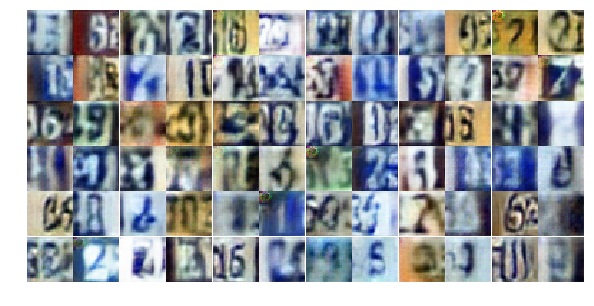

Epoch 13/20... Discriminator Loss: 1.2108... Generator Loss: 0.7213
Epoch 13/20... Discriminator Loss: 1.3580... Generator Loss: 0.6986
Epoch 13/20... Discriminator Loss: 1.3753... Generator Loss: 0.6935
Epoch 13/20... Discriminator Loss: 1.3257... Generator Loss: 0.7866
Epoch 13/20... Discriminator Loss: 1.3553... Generator Loss: 0.7545
Epoch 13/20... Discriminator Loss: 1.3732... Generator Loss: 0.6776
Epoch 13/20... Discriminator Loss: 1.3209... Generator Loss: 0.7205
Epoch 13/20... Discriminator Loss: 1.4020... Generator Loss: 0.6735
Epoch 13/20... Discriminator Loss: 1.3717... Generator Loss: 0.7178
Epoch 13/20... Discriminator Loss: 1.3501... Generator Loss: 0.7149


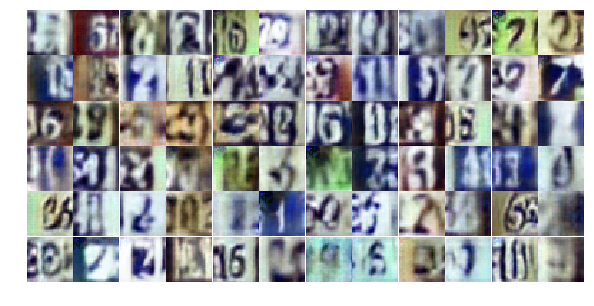

Epoch 13/20... Discriminator Loss: 1.3139... Generator Loss: 0.6902
Epoch 13/20... Discriminator Loss: 1.4421... Generator Loss: 0.6704
Epoch 13/20... Discriminator Loss: 1.2870... Generator Loss: 0.9712
Epoch 13/20... Discriminator Loss: 1.3233... Generator Loss: 0.7415
Epoch 13/20... Discriminator Loss: 1.3712... Generator Loss: 0.6780
Epoch 13/20... Discriminator Loss: 1.3626... Generator Loss: 0.7769
Epoch 13/20... Discriminator Loss: 1.3050... Generator Loss: 0.6979
Epoch 13/20... Discriminator Loss: 1.3435... Generator Loss: 0.7212
Epoch 13/20... Discriminator Loss: 1.3275... Generator Loss: 0.7142
Epoch 13/20... Discriminator Loss: 1.2938... Generator Loss: 0.7539


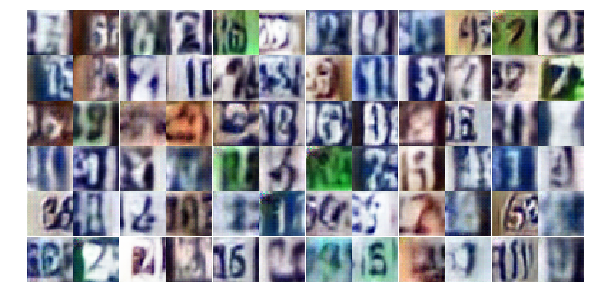

Epoch 13/20... Discriminator Loss: 1.3175... Generator Loss: 0.6990
Epoch 13/20... Discriminator Loss: 1.3457... Generator Loss: 0.6716
Epoch 13/20... Discriminator Loss: 1.3340... Generator Loss: 0.7412
Epoch 13/20... Discriminator Loss: 1.3283... Generator Loss: 0.7252
Epoch 14/20... Discriminator Loss: 1.3631... Generator Loss: 0.7799
Epoch 14/20... Discriminator Loss: 1.3534... Generator Loss: 0.6917
Epoch 14/20... Discriminator Loss: 1.2972... Generator Loss: 0.7187
Epoch 14/20... Discriminator Loss: 1.2896... Generator Loss: 0.7174
Epoch 14/20... Discriminator Loss: 1.3237... Generator Loss: 0.6621
Epoch 14/20... Discriminator Loss: 1.3390... Generator Loss: 0.7206


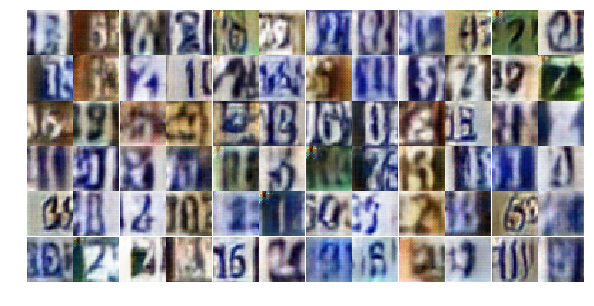

Epoch 14/20... Discriminator Loss: 1.3835... Generator Loss: 0.6981
Epoch 14/20... Discriminator Loss: 1.2782... Generator Loss: 0.7428
Epoch 14/20... Discriminator Loss: 1.3064... Generator Loss: 0.6811
Epoch 14/20... Discriminator Loss: 1.4105... Generator Loss: 0.6953
Epoch 14/20... Discriminator Loss: 1.2143... Generator Loss: 0.7969
Epoch 14/20... Discriminator Loss: 1.5503... Generator Loss: 0.7451
Epoch 14/20... Discriminator Loss: 1.4033... Generator Loss: 0.6693
Epoch 14/20... Discriminator Loss: 1.3570... Generator Loss: 0.7430
Epoch 14/20... Discriminator Loss: 1.3812... Generator Loss: 0.7251
Epoch 14/20... Discriminator Loss: 1.3649... Generator Loss: 0.7241


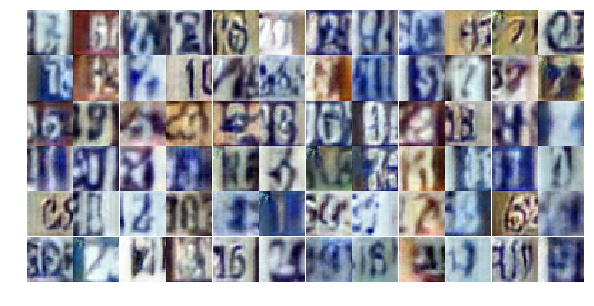

Epoch 14/20... Discriminator Loss: 1.3268... Generator Loss: 0.7760
Epoch 14/20... Discriminator Loss: 1.4766... Generator Loss: 0.6892
Epoch 14/20... Discriminator Loss: 1.3270... Generator Loss: 0.7419
Epoch 14/20... Discriminator Loss: 1.3615... Generator Loss: 0.6862
Epoch 14/20... Discriminator Loss: 1.3042... Generator Loss: 0.7194
Epoch 14/20... Discriminator Loss: 1.3229... Generator Loss: 0.7087
Epoch 14/20... Discriminator Loss: 1.3433... Generator Loss: 0.7192
Epoch 14/20... Discriminator Loss: 1.3516... Generator Loss: 0.7507
Epoch 14/20... Discriminator Loss: 1.3443... Generator Loss: 0.6960
Epoch 14/20... Discriminator Loss: 1.3646... Generator Loss: 0.7371


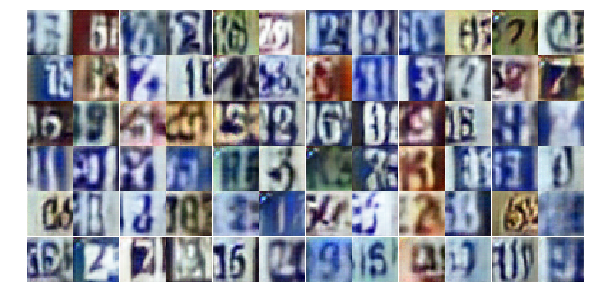

Epoch 14/20... Discriminator Loss: 1.3338... Generator Loss: 0.7461
Epoch 14/20... Discriminator Loss: 1.3158... Generator Loss: 0.7049
Epoch 14/20... Discriminator Loss: 1.2757... Generator Loss: 0.7528
Epoch 14/20... Discriminator Loss: 1.3574... Generator Loss: 0.6817
Epoch 14/20... Discriminator Loss: 1.3273... Generator Loss: 0.7622
Epoch 14/20... Discriminator Loss: 1.3060... Generator Loss: 0.6973
Epoch 14/20... Discriminator Loss: 1.3385... Generator Loss: 0.7105
Epoch 14/20... Discriminator Loss: 1.3117... Generator Loss: 0.6778
Epoch 14/20... Discriminator Loss: 1.4004... Generator Loss: 0.7890
Epoch 14/20... Discriminator Loss: 1.3628... Generator Loss: 0.7307


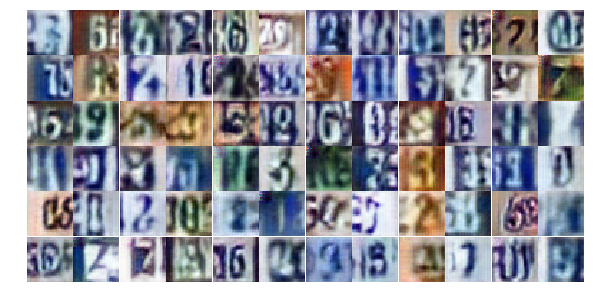

Epoch 14/20... Discriminator Loss: 1.3121... Generator Loss: 0.6894
Epoch 14/20... Discriminator Loss: 1.3612... Generator Loss: 0.6886
Epoch 14/20... Discriminator Loss: 1.3355... Generator Loss: 0.6660
Epoch 14/20... Discriminator Loss: 1.3212... Generator Loss: 0.7352
Epoch 14/20... Discriminator Loss: 1.4842... Generator Loss: 0.6064
Epoch 14/20... Discriminator Loss: 1.4211... Generator Loss: 0.5974
Epoch 14/20... Discriminator Loss: 1.3227... Generator Loss: 0.6818
Epoch 14/20... Discriminator Loss: 1.3242... Generator Loss: 0.7232
Epoch 14/20... Discriminator Loss: 1.3083... Generator Loss: 0.7253
Epoch 14/20... Discriminator Loss: 1.3191... Generator Loss: 0.6894


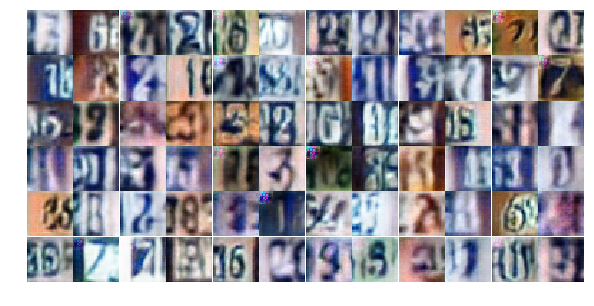

Epoch 14/20... Discriminator Loss: 1.3490... Generator Loss: 0.6824
Epoch 14/20... Discriminator Loss: 1.3990... Generator Loss: 0.7135
Epoch 14/20... Discriminator Loss: 1.3204... Generator Loss: 0.6786
Epoch 14/20... Discriminator Loss: 1.3417... Generator Loss: 0.7089
Epoch 14/20... Discriminator Loss: 1.3395... Generator Loss: 0.6863
Epoch 14/20... Discriminator Loss: 1.3510... Generator Loss: 0.7574
Epoch 14/20... Discriminator Loss: 1.3490... Generator Loss: 0.7036
Epoch 14/20... Discriminator Loss: 1.3032... Generator Loss: 0.7521
Epoch 14/20... Discriminator Loss: 1.4177... Generator Loss: 0.6764
Epoch 14/20... Discriminator Loss: 1.3368... Generator Loss: 0.7111


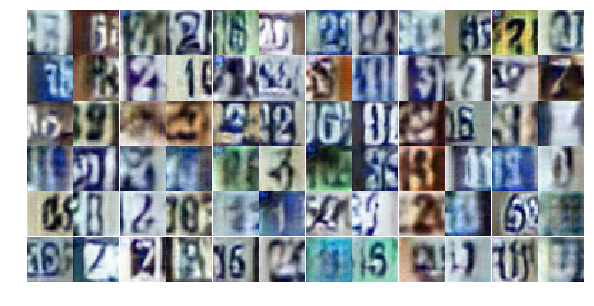

Epoch 14/20... Discriminator Loss: 1.3213... Generator Loss: 0.7353
Epoch 14/20... Discriminator Loss: 1.3836... Generator Loss: 0.6833
Epoch 15/20... Discriminator Loss: 1.3834... Generator Loss: 0.6838
Epoch 15/20... Discriminator Loss: 1.3699... Generator Loss: 0.7037
Epoch 15/20... Discriminator Loss: 1.2268... Generator Loss: 0.7767
Epoch 15/20... Discriminator Loss: 1.3349... Generator Loss: 0.7590
Epoch 15/20... Discriminator Loss: 1.3116... Generator Loss: 0.6931
Epoch 15/20... Discriminator Loss: 1.4079... Generator Loss: 0.6803
Epoch 15/20... Discriminator Loss: 1.4385... Generator Loss: 0.7338
Epoch 15/20... Discriminator Loss: 1.3306... Generator Loss: 0.7403


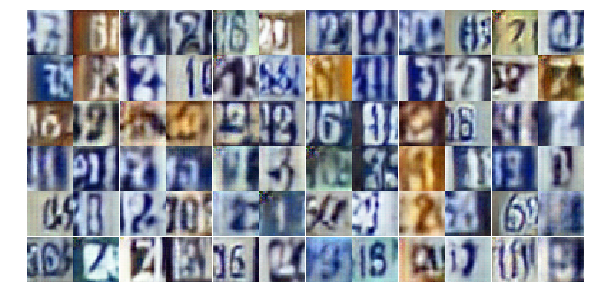

Epoch 15/20... Discriminator Loss: 1.3502... Generator Loss: 0.7511
Epoch 15/20... Discriminator Loss: 1.2871... Generator Loss: 0.6976
Epoch 15/20... Discriminator Loss: 1.3964... Generator Loss: 0.6649
Epoch 15/20... Discriminator Loss: 1.3883... Generator Loss: 0.7369
Epoch 15/20... Discriminator Loss: 1.3694... Generator Loss: 0.6912
Epoch 15/20... Discriminator Loss: 1.2052... Generator Loss: 0.7252
Epoch 15/20... Discriminator Loss: 1.3041... Generator Loss: 0.7997
Epoch 15/20... Discriminator Loss: 1.3425... Generator Loss: 0.6681
Epoch 15/20... Discriminator Loss: 1.3937... Generator Loss: 0.6481
Epoch 15/20... Discriminator Loss: 1.2642... Generator Loss: 0.6864


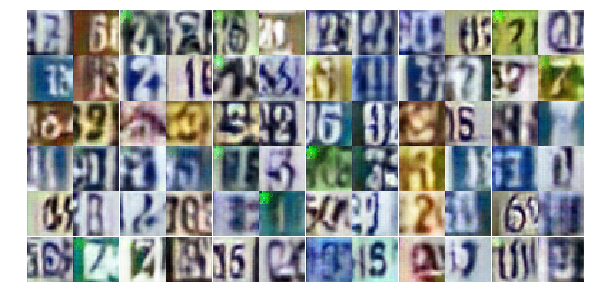

Epoch 15/20... Discriminator Loss: 1.4235... Generator Loss: 0.7346
Epoch 15/20... Discriminator Loss: 1.3465... Generator Loss: 0.7166
Epoch 15/20... Discriminator Loss: 1.3287... Generator Loss: 0.6918
Epoch 15/20... Discriminator Loss: 1.3591... Generator Loss: 0.7050
Epoch 15/20... Discriminator Loss: 1.4289... Generator Loss: 0.6741
Epoch 15/20... Discriminator Loss: 1.3430... Generator Loss: 0.7554
Epoch 15/20... Discriminator Loss: 1.3902... Generator Loss: 0.6367
Epoch 15/20... Discriminator Loss: 1.3622... Generator Loss: 0.7079
Epoch 15/20... Discriminator Loss: 1.3294... Generator Loss: 0.7653
Epoch 15/20... Discriminator Loss: 1.3494... Generator Loss: 0.7190


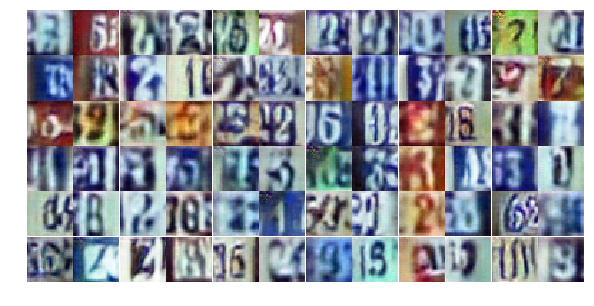

Epoch 15/20... Discriminator Loss: 1.3196... Generator Loss: 0.7842
Epoch 15/20... Discriminator Loss: 1.3253... Generator Loss: 0.7400
Epoch 15/20... Discriminator Loss: 1.3103... Generator Loss: 0.7007
Epoch 15/20... Discriminator Loss: 1.3727... Generator Loss: 0.7123
Epoch 15/20... Discriminator Loss: 1.2697... Generator Loss: 0.7138
Epoch 15/20... Discriminator Loss: 1.3446... Generator Loss: 0.6967
Epoch 15/20... Discriminator Loss: 1.4056... Generator Loss: 0.6599
Epoch 15/20... Discriminator Loss: 1.3253... Generator Loss: 0.7063
Epoch 15/20... Discriminator Loss: 1.4154... Generator Loss: 0.7094
Epoch 15/20... Discriminator Loss: 1.3142... Generator Loss: 0.7219


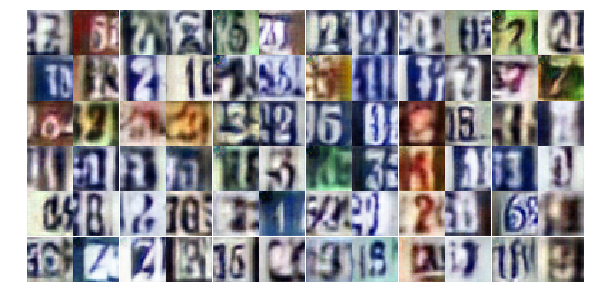

Epoch 15/20... Discriminator Loss: 1.4266... Generator Loss: 0.6661
Epoch 15/20... Discriminator Loss: 1.3492... Generator Loss: 0.7256
Epoch 15/20... Discriminator Loss: 1.2959... Generator Loss: 0.7891
Epoch 15/20... Discriminator Loss: 1.3693... Generator Loss: 0.7846
Epoch 15/20... Discriminator Loss: 1.3512... Generator Loss: 0.6918
Epoch 15/20... Discriminator Loss: 1.2823... Generator Loss: 0.6854
Epoch 15/20... Discriminator Loss: 1.2564... Generator Loss: 0.7937
Epoch 15/20... Discriminator Loss: 1.2633... Generator Loss: 0.8053
Epoch 15/20... Discriminator Loss: 1.3858... Generator Loss: 0.7217
Epoch 15/20... Discriminator Loss: 1.3510... Generator Loss: 0.7345


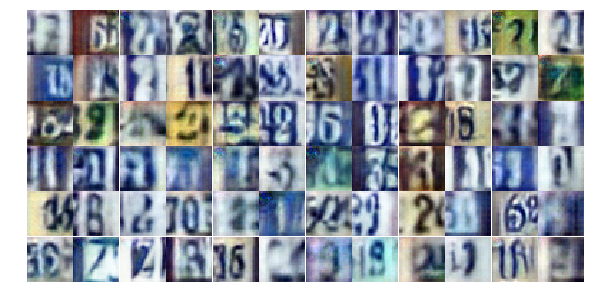

Epoch 15/20... Discriminator Loss: 1.4548... Generator Loss: 0.6681
Epoch 15/20... Discriminator Loss: 1.2547... Generator Loss: 0.7529
Epoch 15/20... Discriminator Loss: 1.2353... Generator Loss: 0.7352
Epoch 15/20... Discriminator Loss: 1.3281... Generator Loss: 0.7027
Epoch 15/20... Discriminator Loss: 1.3543... Generator Loss: 0.7679
Epoch 15/20... Discriminator Loss: 1.3520... Generator Loss: 0.6699
Epoch 15/20... Discriminator Loss: 1.3142... Generator Loss: 0.6903
Epoch 15/20... Discriminator Loss: 1.3908... Generator Loss: 0.6570
Epoch 15/20... Discriminator Loss: 1.3279... Generator Loss: 0.7088
Epoch 16/20... Discriminator Loss: 1.4234... Generator Loss: 0.6927


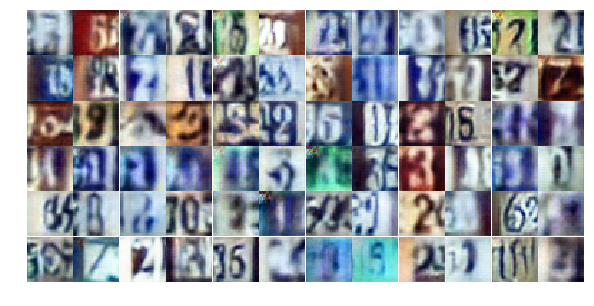

Epoch 16/20... Discriminator Loss: 1.2885... Generator Loss: 0.6923
Epoch 16/20... Discriminator Loss: 1.4112... Generator Loss: 0.6603
Epoch 16/20... Discriminator Loss: 1.0602... Generator Loss: 1.0380
Epoch 16/20... Discriminator Loss: 1.1081... Generator Loss: 0.8919
Epoch 16/20... Discriminator Loss: 1.1885... Generator Loss: 0.7747
Epoch 16/20... Discriminator Loss: 1.2346... Generator Loss: 0.7843
Epoch 16/20... Discriminator Loss: 1.2724... Generator Loss: 0.7477
Epoch 16/20... Discriminator Loss: 1.3007... Generator Loss: 0.6993
Epoch 16/20... Discriminator Loss: 1.3270... Generator Loss: 0.7431
Epoch 16/20... Discriminator Loss: 1.2461... Generator Loss: 0.6766


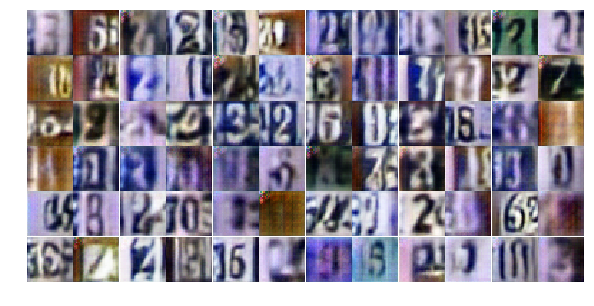

Epoch 16/20... Discriminator Loss: 1.3073... Generator Loss: 0.7773
Epoch 16/20... Discriminator Loss: 1.3828... Generator Loss: 0.6408
Epoch 16/20... Discriminator Loss: 1.4131... Generator Loss: 0.7645
Epoch 16/20... Discriminator Loss: 1.2917... Generator Loss: 0.7027
Epoch 16/20... Discriminator Loss: 1.2920... Generator Loss: 0.7189
Epoch 16/20... Discriminator Loss: 1.4544... Generator Loss: 0.6847
Epoch 16/20... Discriminator Loss: 1.3161... Generator Loss: 0.6897
Epoch 16/20... Discriminator Loss: 1.3386... Generator Loss: 0.7605
Epoch 16/20... Discriminator Loss: 1.2865... Generator Loss: 0.7216
Epoch 16/20... Discriminator Loss: 1.3051... Generator Loss: 0.7039


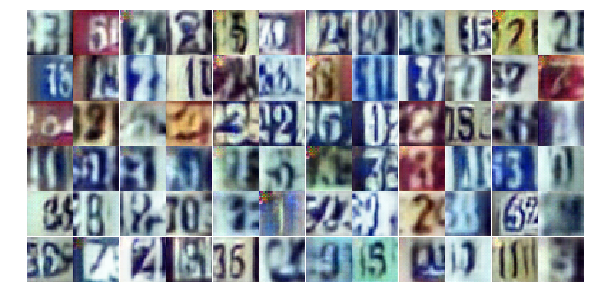

Epoch 16/20... Discriminator Loss: 1.3642... Generator Loss: 0.7313
Epoch 16/20... Discriminator Loss: 1.3794... Generator Loss: 0.6804
Epoch 16/20... Discriminator Loss: 1.3856... Generator Loss: 0.6518
Epoch 16/20... Discriminator Loss: 1.2392... Generator Loss: 0.7449
Epoch 16/20... Discriminator Loss: 1.3045... Generator Loss: 0.7124
Epoch 16/20... Discriminator Loss: 1.3090... Generator Loss: 0.7279
Epoch 16/20... Discriminator Loss: 1.3561... Generator Loss: 0.6733
Epoch 16/20... Discriminator Loss: 1.3510... Generator Loss: 0.7649
Epoch 16/20... Discriminator Loss: 1.2554... Generator Loss: 0.6942
Epoch 16/20... Discriminator Loss: 1.3346... Generator Loss: 0.7653


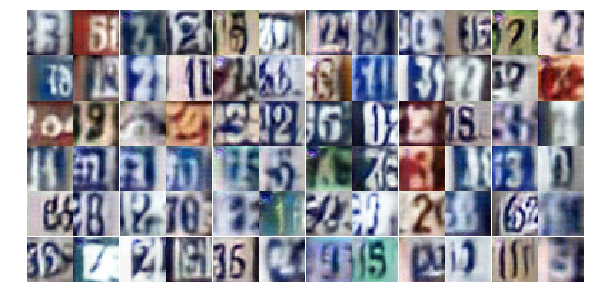

Epoch 16/20... Discriminator Loss: 1.3541... Generator Loss: 0.7571
Epoch 16/20... Discriminator Loss: 1.3394... Generator Loss: 0.7556
Epoch 16/20... Discriminator Loss: 1.3962... Generator Loss: 0.7048
Epoch 16/20... Discriminator Loss: 1.3583... Generator Loss: 0.8547
Epoch 16/20... Discriminator Loss: 1.3849... Generator Loss: 0.6289
Epoch 16/20... Discriminator Loss: 1.3952... Generator Loss: 0.6612
Epoch 16/20... Discriminator Loss: 1.2563... Generator Loss: 0.7416
Epoch 16/20... Discriminator Loss: 1.1770... Generator Loss: 0.7663
Epoch 16/20... Discriminator Loss: 1.2458... Generator Loss: 0.7090
Epoch 16/20... Discriminator Loss: 1.4802... Generator Loss: 0.6358


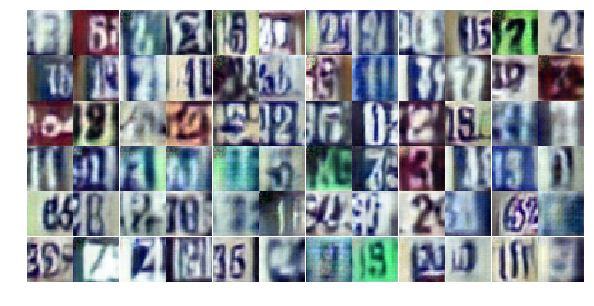

Epoch 16/20... Discriminator Loss: 1.2965... Generator Loss: 0.7524
Epoch 16/20... Discriminator Loss: 1.3895... Generator Loss: 0.7380
Epoch 16/20... Discriminator Loss: 1.2971... Generator Loss: 0.8344
Epoch 16/20... Discriminator Loss: 1.3725... Generator Loss: 0.7107
Epoch 16/20... Discriminator Loss: 1.3245... Generator Loss: 0.8278
Epoch 16/20... Discriminator Loss: 1.3091... Generator Loss: 0.7395
Epoch 16/20... Discriminator Loss: 1.2830... Generator Loss: 0.7760
Epoch 16/20... Discriminator Loss: 1.2621... Generator Loss: 0.7988
Epoch 16/20... Discriminator Loss: 1.1596... Generator Loss: 0.7990
Epoch 16/20... Discriminator Loss: 1.3536... Generator Loss: 0.6995


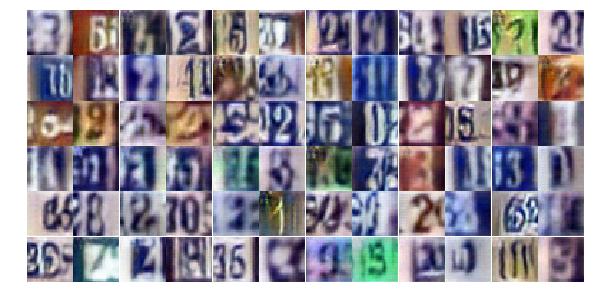

Epoch 16/20... Discriminator Loss: 1.3736... Generator Loss: 0.6952
Epoch 16/20... Discriminator Loss: 1.3228... Generator Loss: 0.8908
Epoch 16/20... Discriminator Loss: 1.3628... Generator Loss: 0.6898
Epoch 16/20... Discriminator Loss: 1.0992... Generator Loss: 0.7534
Epoch 16/20... Discriminator Loss: 1.4188... Generator Loss: 0.6025
Epoch 16/20... Discriminator Loss: 1.2136... Generator Loss: 0.7903
Epoch 17/20... Discriminator Loss: 1.4160... Generator Loss: 0.6223
Epoch 17/20... Discriminator Loss: 1.2781... Generator Loss: 0.7357
Epoch 17/20... Discriminator Loss: 1.3435... Generator Loss: 0.7177
Epoch 17/20... Discriminator Loss: 1.3853... Generator Loss: 0.6068


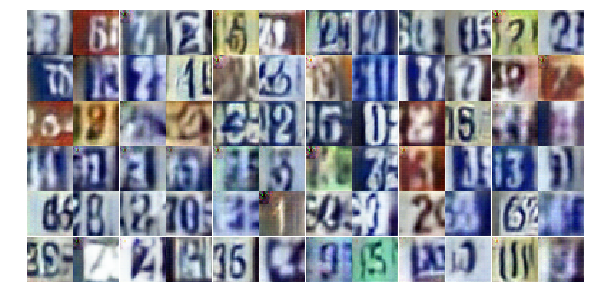

Epoch 17/20... Discriminator Loss: 1.3669... Generator Loss: 0.7286
Epoch 17/20... Discriminator Loss: 1.4355... Generator Loss: 0.6712
Epoch 17/20... Discriminator Loss: 1.3138... Generator Loss: 0.7363
Epoch 17/20... Discriminator Loss: 1.3224... Generator Loss: 0.6881
Epoch 17/20... Discriminator Loss: 1.2306... Generator Loss: 0.7272
Epoch 17/20... Discriminator Loss: 1.3838... Generator Loss: 0.7578
Epoch 17/20... Discriminator Loss: 1.2112... Generator Loss: 0.7642
Epoch 17/20... Discriminator Loss: 1.4324... Generator Loss: 0.7100
Epoch 17/20... Discriminator Loss: 1.3723... Generator Loss: 0.8258
Epoch 17/20... Discriminator Loss: 1.2396... Generator Loss: 0.7343


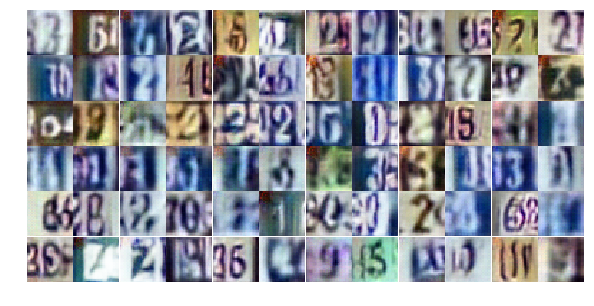

Epoch 17/20... Discriminator Loss: 1.3212... Generator Loss: 0.6575
Epoch 17/20... Discriminator Loss: 1.2608... Generator Loss: 0.8316
Epoch 17/20... Discriminator Loss: 1.2380... Generator Loss: 0.7962
Epoch 17/20... Discriminator Loss: 1.3456... Generator Loss: 0.6918
Epoch 17/20... Discriminator Loss: 1.4003... Generator Loss: 0.6596
Epoch 17/20... Discriminator Loss: 1.2161... Generator Loss: 0.7342
Epoch 17/20... Discriminator Loss: 1.2940... Generator Loss: 0.7955
Epoch 17/20... Discriminator Loss: 1.3445... Generator Loss: 0.7154
Epoch 17/20... Discriminator Loss: 1.2657... Generator Loss: 0.7446
Epoch 17/20... Discriminator Loss: 1.3014... Generator Loss: 0.8940


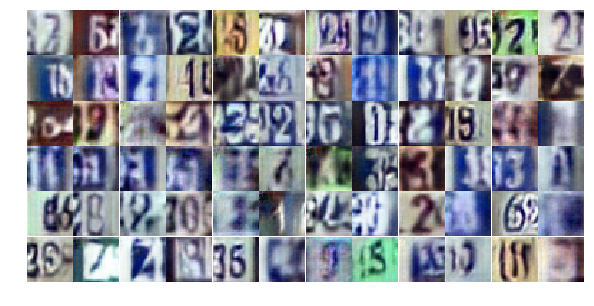

Epoch 17/20... Discriminator Loss: 1.3333... Generator Loss: 0.7587
Epoch 17/20... Discriminator Loss: 1.3792... Generator Loss: 0.6796
Epoch 17/20... Discriminator Loss: 1.4177... Generator Loss: 0.7115
Epoch 17/20... Discriminator Loss: 1.4215... Generator Loss: 0.6795
Epoch 17/20... Discriminator Loss: 1.3282... Generator Loss: 0.7438
Epoch 17/20... Discriminator Loss: 1.2290... Generator Loss: 0.7430
Epoch 17/20... Discriminator Loss: 1.3222... Generator Loss: 0.7621
Epoch 17/20... Discriminator Loss: 1.2522... Generator Loss: 0.6602
Epoch 17/20... Discriminator Loss: 1.2018... Generator Loss: 0.6485
Epoch 17/20... Discriminator Loss: 1.6578... Generator Loss: 0.5649


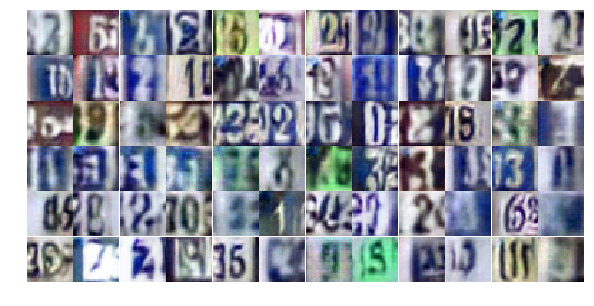

Epoch 17/20... Discriminator Loss: 1.1735... Generator Loss: 0.7725
Epoch 17/20... Discriminator Loss: 1.3805... Generator Loss: 0.7013
Epoch 17/20... Discriminator Loss: 1.2182... Generator Loss: 0.6960
Epoch 17/20... Discriminator Loss: 1.1801... Generator Loss: 0.8552
Epoch 17/20... Discriminator Loss: 1.4807... Generator Loss: 0.5666
Epoch 17/20... Discriminator Loss: 1.3698... Generator Loss: 0.7085
Epoch 17/20... Discriminator Loss: 1.2618... Generator Loss: 0.8342
Epoch 17/20... Discriminator Loss: 1.1901... Generator Loss: 0.8434
Epoch 17/20... Discriminator Loss: 1.2146... Generator Loss: 0.7509
Epoch 17/20... Discriminator Loss: 1.7112... Generator Loss: 0.5474


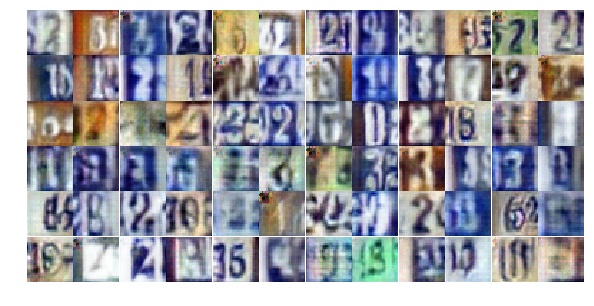

Epoch 17/20... Discriminator Loss: 1.1515... Generator Loss: 0.7519
Epoch 17/20... Discriminator Loss: 1.2691... Generator Loss: 0.7689
Epoch 17/20... Discriminator Loss: 1.4911... Generator Loss: 0.6442
Epoch 17/20... Discriminator Loss: 1.3384... Generator Loss: 0.7287
Epoch 17/20... Discriminator Loss: 1.3875... Generator Loss: 0.7174
Epoch 17/20... Discriminator Loss: 1.3596... Generator Loss: 0.6124
Epoch 17/20... Discriminator Loss: 1.2082... Generator Loss: 0.7541
Epoch 17/20... Discriminator Loss: 1.3527... Generator Loss: 0.6819
Epoch 17/20... Discriminator Loss: 1.3733... Generator Loss: 0.7053
Epoch 17/20... Discriminator Loss: 1.1634... Generator Loss: 0.9264


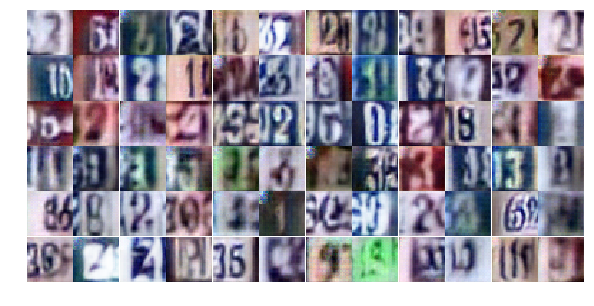

Epoch 17/20... Discriminator Loss: 1.3115... Generator Loss: 0.6810
Epoch 17/20... Discriminator Loss: 1.4822... Generator Loss: 0.6989
Epoch 17/20... Discriminator Loss: 1.3431... Generator Loss: 0.7343
Epoch 17/20... Discriminator Loss: 1.3618... Generator Loss: 0.7043
Epoch 18/20... Discriminator Loss: 1.3044... Generator Loss: 0.7825
Epoch 18/20... Discriminator Loss: 1.3548... Generator Loss: 0.7269
Epoch 18/20... Discriminator Loss: 1.3174... Generator Loss: 0.7432
Epoch 18/20... Discriminator Loss: 1.2339... Generator Loss: 0.8563
Epoch 18/20... Discriminator Loss: 1.3812... Generator Loss: 0.7219
Epoch 18/20... Discriminator Loss: 1.2867... Generator Loss: 0.7483


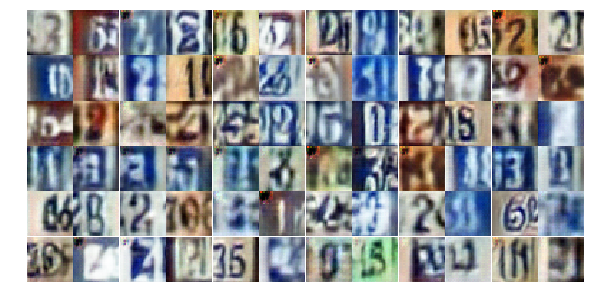

Epoch 18/20... Discriminator Loss: 1.2873... Generator Loss: 0.7238
Epoch 18/20... Discriminator Loss: 1.4957... Generator Loss: 0.6329
Epoch 18/20... Discriminator Loss: 1.3140... Generator Loss: 0.7513
Epoch 18/20... Discriminator Loss: 0.9082... Generator Loss: 0.9976
Epoch 18/20... Discriminator Loss: 1.3083... Generator Loss: 0.7820
Epoch 18/20... Discriminator Loss: 1.0527... Generator Loss: 0.9953
Epoch 18/20... Discriminator Loss: 1.2929... Generator Loss: 0.6706
Epoch 18/20... Discriminator Loss: 1.8199... Generator Loss: 0.9498
Epoch 18/20... Discriminator Loss: 1.3715... Generator Loss: 0.8108
Epoch 18/20... Discriminator Loss: 1.3747... Generator Loss: 0.7213


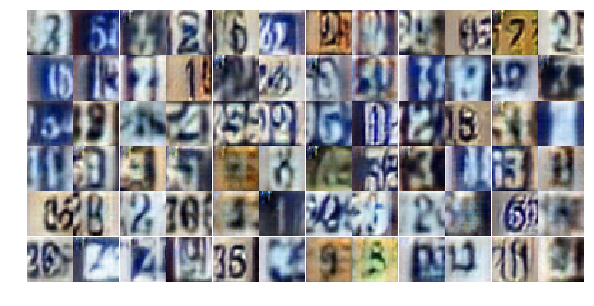

Epoch 18/20... Discriminator Loss: 1.2514... Generator Loss: 0.7167
Epoch 18/20... Discriminator Loss: 1.2418... Generator Loss: 0.6874
Epoch 18/20... Discriminator Loss: 1.5256... Generator Loss: 0.6226
Epoch 18/20... Discriminator Loss: 1.3122... Generator Loss: 0.8200
Epoch 18/20... Discriminator Loss: 1.3093... Generator Loss: 0.7737
Epoch 18/20... Discriminator Loss: 1.3482... Generator Loss: 0.6958
Epoch 18/20... Discriminator Loss: 1.2151... Generator Loss: 0.8973
Epoch 18/20... Discriminator Loss: 1.3299... Generator Loss: 0.7246
Epoch 18/20... Discriminator Loss: 1.3053... Generator Loss: 0.7070
Epoch 18/20... Discriminator Loss: 1.3165... Generator Loss: 0.8051


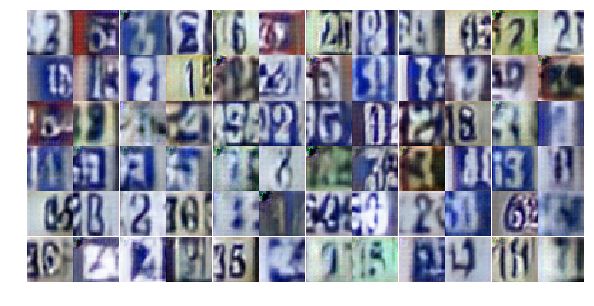

Epoch 18/20... Discriminator Loss: 1.3986... Generator Loss: 0.8199
Epoch 18/20... Discriminator Loss: 1.2931... Generator Loss: 0.8080
Epoch 18/20... Discriminator Loss: 1.4022... Generator Loss: 0.6956
Epoch 18/20... Discriminator Loss: 1.2661... Generator Loss: 0.7163
Epoch 18/20... Discriminator Loss: 1.2537... Generator Loss: 0.8438
Epoch 18/20... Discriminator Loss: 1.3415... Generator Loss: 0.6855
Epoch 18/20... Discriminator Loss: 1.3053... Generator Loss: 0.7622
Epoch 18/20... Discriminator Loss: 1.1747... Generator Loss: 0.9757
Epoch 18/20... Discriminator Loss: 1.1232... Generator Loss: 0.9114
Epoch 18/20... Discriminator Loss: 1.4318... Generator Loss: 0.5750


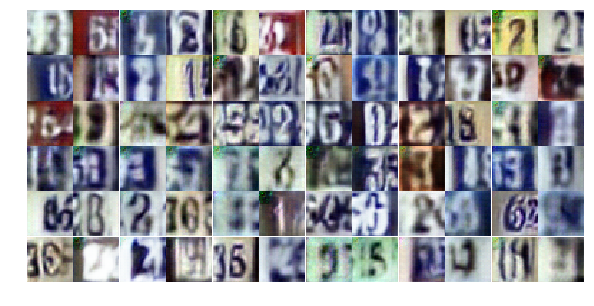

Epoch 18/20... Discriminator Loss: 1.3060... Generator Loss: 0.9454
Epoch 18/20... Discriminator Loss: 1.3239... Generator Loss: 0.7064
Epoch 18/20... Discriminator Loss: 1.2631... Generator Loss: 0.7972
Epoch 18/20... Discriminator Loss: 1.1751... Generator Loss: 0.6651
Epoch 18/20... Discriminator Loss: 1.3487... Generator Loss: 0.8420
Epoch 18/20... Discriminator Loss: 1.2490... Generator Loss: 0.7603
Epoch 18/20... Discriminator Loss: 1.2121... Generator Loss: 0.6381
Epoch 18/20... Discriminator Loss: 1.2748... Generator Loss: 0.6776
Epoch 18/20... Discriminator Loss: 1.2821... Generator Loss: 0.7892
Epoch 18/20... Discriminator Loss: 1.2354... Generator Loss: 0.8057


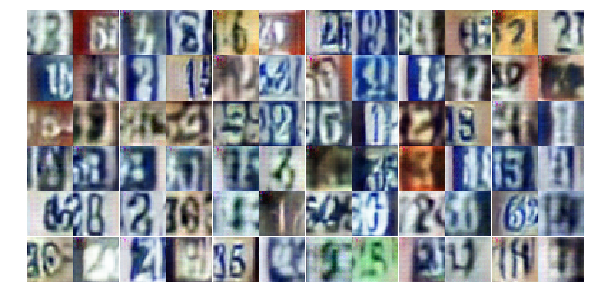

Epoch 18/20... Discriminator Loss: 1.2413... Generator Loss: 0.8324
Epoch 18/20... Discriminator Loss: 1.9853... Generator Loss: 1.1001
Epoch 18/20... Discriminator Loss: 1.3808... Generator Loss: 0.6841
Epoch 18/20... Discriminator Loss: 1.4913... Generator Loss: 0.6332
Epoch 18/20... Discriminator Loss: 1.2973... Generator Loss: 0.6778
Epoch 18/20... Discriminator Loss: 1.3127... Generator Loss: 0.7392
Epoch 18/20... Discriminator Loss: 1.2756... Generator Loss: 0.7391
Epoch 18/20... Discriminator Loss: 1.3295... Generator Loss: 0.6941
Epoch 18/20... Discriminator Loss: 1.5468... Generator Loss: 0.5327
Epoch 18/20... Discriminator Loss: 1.3091... Generator Loss: 0.7329


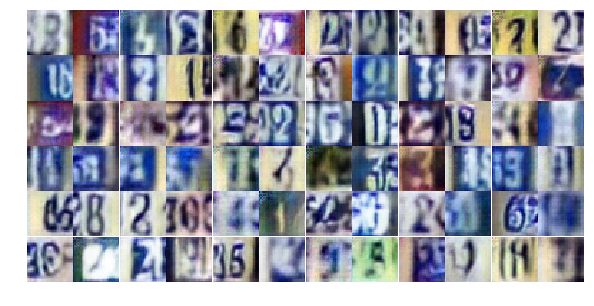

Epoch 18/20... Discriminator Loss: 1.3841... Generator Loss: 0.6483
Epoch 19/20... Discriminator Loss: 1.3145... Generator Loss: 0.7547
Epoch 19/20... Discriminator Loss: 1.3431... Generator Loss: 0.7350
Epoch 19/20... Discriminator Loss: 1.3412... Generator Loss: 0.7229
Epoch 19/20... Discriminator Loss: 1.2930... Generator Loss: 0.7153
Epoch 19/20... Discriminator Loss: 1.3944... Generator Loss: 0.7022
Epoch 19/20... Discriminator Loss: 1.1722... Generator Loss: 0.7171
Epoch 19/20... Discriminator Loss: 1.3620... Generator Loss: 0.6738
Epoch 19/20... Discriminator Loss: 1.2662... Generator Loss: 0.7457
Epoch 19/20... Discriminator Loss: 1.4282... Generator Loss: 0.6558


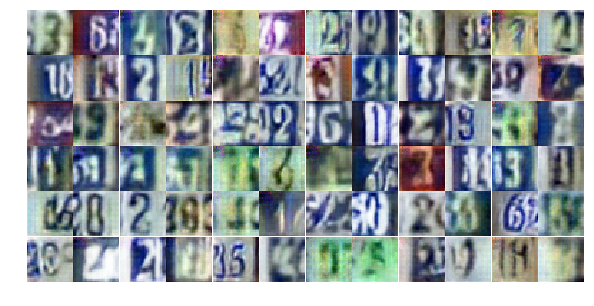

Epoch 19/20... Discriminator Loss: 1.1754... Generator Loss: 0.8115
Epoch 19/20... Discriminator Loss: 1.2626... Generator Loss: 0.6908
Epoch 19/20... Discriminator Loss: 1.3307... Generator Loss: 0.7047
Epoch 19/20... Discriminator Loss: 1.3204... Generator Loss: 0.7687
Epoch 19/20... Discriminator Loss: 1.2211... Generator Loss: 0.7596
Epoch 19/20... Discriminator Loss: 1.3623... Generator Loss: 0.6078
Epoch 19/20... Discriminator Loss: 1.3360... Generator Loss: 0.7897
Epoch 19/20... Discriminator Loss: 1.2593... Generator Loss: 0.7194
Epoch 19/20... Discriminator Loss: 1.4163... Generator Loss: 0.7593
Epoch 19/20... Discriminator Loss: 1.1524... Generator Loss: 0.7538


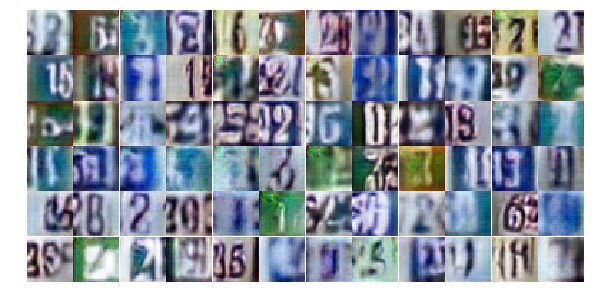

Epoch 19/20... Discriminator Loss: 1.2683... Generator Loss: 0.7799
Epoch 19/20... Discriminator Loss: 1.3626... Generator Loss: 0.7004
Epoch 19/20... Discriminator Loss: 1.3884... Generator Loss: 0.7188
Epoch 19/20... Discriminator Loss: 1.3091... Generator Loss: 0.7310
Epoch 19/20... Discriminator Loss: 1.3292... Generator Loss: 0.7170
Epoch 19/20... Discriminator Loss: 1.3573... Generator Loss: 0.6954
Epoch 19/20... Discriminator Loss: 1.2767... Generator Loss: 0.6511
Epoch 19/20... Discriminator Loss: 1.3471... Generator Loss: 0.7354
Epoch 19/20... Discriminator Loss: 1.2322... Generator Loss: 0.7359
Epoch 19/20... Discriminator Loss: 1.4986... Generator Loss: 0.5277


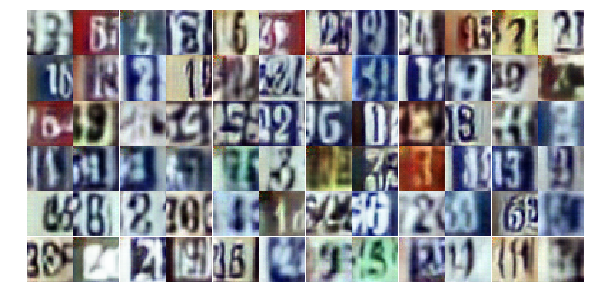

Epoch 19/20... Discriminator Loss: 1.4367... Generator Loss: 0.6305
Epoch 19/20... Discriminator Loss: 1.4661... Generator Loss: 0.7327
Epoch 19/20... Discriminator Loss: 1.1792... Generator Loss: 0.7964
Epoch 19/20... Discriminator Loss: 1.2416... Generator Loss: 0.7178
Epoch 19/20... Discriminator Loss: 1.4610... Generator Loss: 0.7630
Epoch 19/20... Discriminator Loss: 1.3186... Generator Loss: 0.6313
Epoch 19/20... Discriminator Loss: 1.8036... Generator Loss: 0.4208
Epoch 19/20... Discriminator Loss: 1.3068... Generator Loss: 0.8401
Epoch 19/20... Discriminator Loss: 1.2658... Generator Loss: 0.7376
Epoch 19/20... Discriminator Loss: 1.4795... Generator Loss: 0.6772


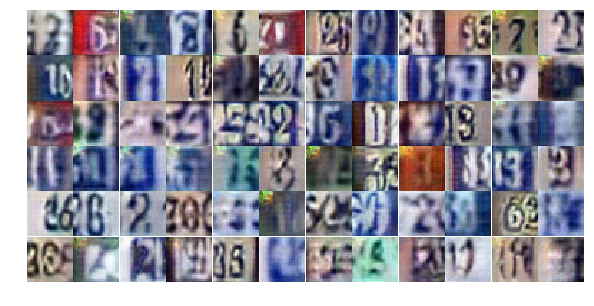

Epoch 19/20... Discriminator Loss: 1.3187... Generator Loss: 0.7191
Epoch 19/20... Discriminator Loss: 1.2912... Generator Loss: 0.7771
Epoch 19/20... Discriminator Loss: 1.3478... Generator Loss: 0.7855
Epoch 19/20... Discriminator Loss: 1.3609... Generator Loss: 0.6147
Epoch 19/20... Discriminator Loss: 1.2075... Generator Loss: 0.6849
Epoch 19/20... Discriminator Loss: 1.5175... Generator Loss: 0.7457
Epoch 19/20... Discriminator Loss: 1.2789... Generator Loss: 0.7582
Epoch 19/20... Discriminator Loss: 1.2485... Generator Loss: 0.7538
Epoch 19/20... Discriminator Loss: 1.1684... Generator Loss: 0.8310
Epoch 19/20... Discriminator Loss: 1.4803... Generator Loss: 0.6622


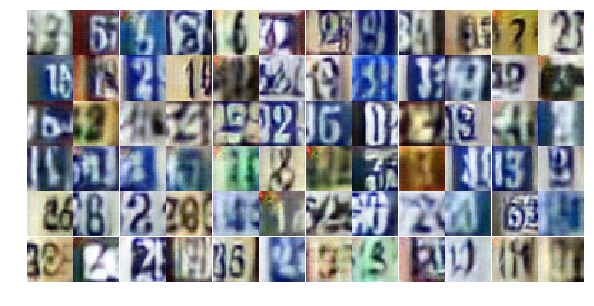

Epoch 19/20... Discriminator Loss: 1.3357... Generator Loss: 0.7855
Epoch 19/20... Discriminator Loss: 1.1345... Generator Loss: 0.7505
Epoch 19/20... Discriminator Loss: 1.3109... Generator Loss: 0.6546
Epoch 19/20... Discriminator Loss: 1.3961... Generator Loss: 0.7212
Epoch 19/20... Discriminator Loss: 1.3427... Generator Loss: 0.6964
Epoch 19/20... Discriminator Loss: 1.3832... Generator Loss: 0.6889
Epoch 19/20... Discriminator Loss: 1.3831... Generator Loss: 0.6947
Epoch 19/20... Discriminator Loss: 1.2105... Generator Loss: 0.7857
Epoch 20/20... Discriminator Loss: 1.4629... Generator Loss: 0.6424
Epoch 20/20... Discriminator Loss: 1.3651... Generator Loss: 0.6445


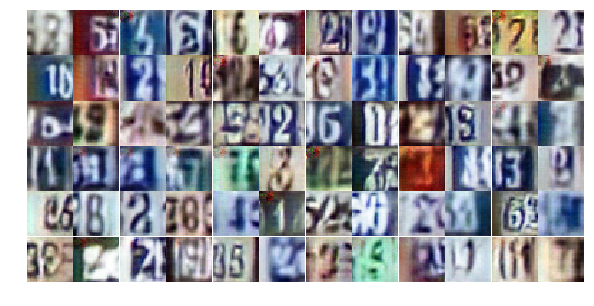

Epoch 20/20... Discriminator Loss: 1.4275... Generator Loss: 0.7159
Epoch 20/20... Discriminator Loss: 1.3677... Generator Loss: 0.6737
Epoch 20/20... Discriminator Loss: 1.1066... Generator Loss: 0.7396
Epoch 20/20... Discriminator Loss: 1.2190... Generator Loss: 0.8762
Epoch 20/20... Discriminator Loss: 1.3260... Generator Loss: 0.7552
Epoch 20/20... Discriminator Loss: 1.2616... Generator Loss: 0.7765
Epoch 20/20... Discriminator Loss: 1.1463... Generator Loss: 0.9448
Epoch 20/20... Discriminator Loss: 1.5246... Generator Loss: 0.8305
Epoch 20/20... Discriminator Loss: 1.4051... Generator Loss: 0.6388
Epoch 20/20... Discriminator Loss: 1.5163... Generator Loss: 0.8060


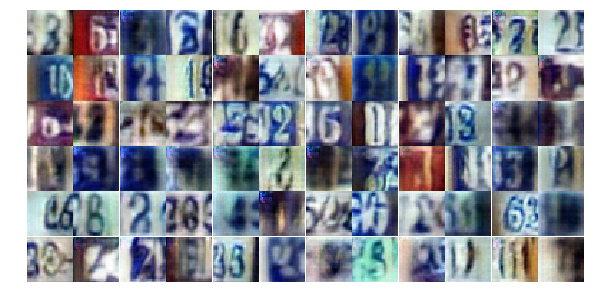

Epoch 20/20... Discriminator Loss: 1.3889... Generator Loss: 0.6885
Epoch 20/20... Discriminator Loss: 1.3826... Generator Loss: 0.7473
Epoch 20/20... Discriminator Loss: 1.3174... Generator Loss: 0.7110
Epoch 20/20... Discriminator Loss: 1.3395... Generator Loss: 0.7303
Epoch 20/20... Discriminator Loss: 1.3788... Generator Loss: 0.7297
Epoch 20/20... Discriminator Loss: 1.3135... Generator Loss: 0.7127
Epoch 20/20... Discriminator Loss: 1.4040... Generator Loss: 0.6586
Epoch 20/20... Discriminator Loss: 1.3911... Generator Loss: 0.6737
Epoch 20/20... Discriminator Loss: 1.2222... Generator Loss: 0.8253
Epoch 20/20... Discriminator Loss: 1.2694... Generator Loss: 0.6883


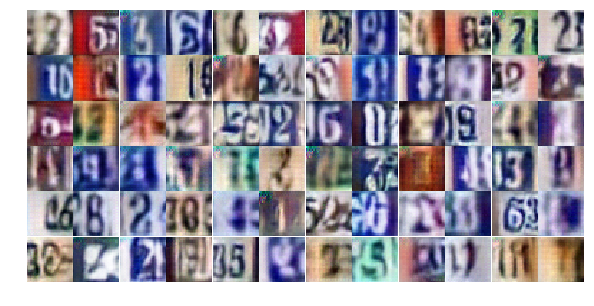

Epoch 20/20... Discriminator Loss: 1.2188... Generator Loss: 0.6946
Epoch 20/20... Discriminator Loss: 1.5782... Generator Loss: 0.7080
Epoch 20/20... Discriminator Loss: 1.2817... Generator Loss: 0.7078
Epoch 20/20... Discriminator Loss: 1.2933... Generator Loss: 0.8296
Epoch 20/20... Discriminator Loss: 1.3147... Generator Loss: 0.5693
Epoch 20/20... Discriminator Loss: 1.1464... Generator Loss: 0.8224
Epoch 20/20... Discriminator Loss: 1.3191... Generator Loss: 0.7500
Epoch 20/20... Discriminator Loss: 1.2774... Generator Loss: 0.6906
Epoch 20/20... Discriminator Loss: 1.5072... Generator Loss: 0.6776
Epoch 20/20... Discriminator Loss: 1.3425... Generator Loss: 0.6981


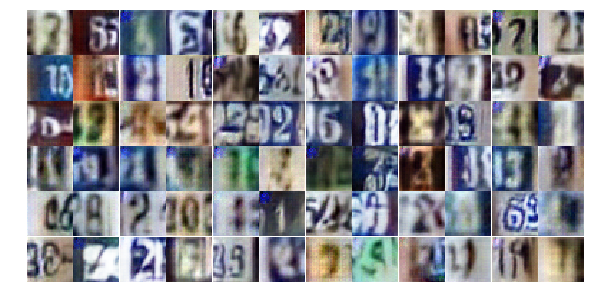

Epoch 20/20... Discriminator Loss: 1.1283... Generator Loss: 0.7681
Epoch 20/20... Discriminator Loss: 1.3054... Generator Loss: 0.6813
Epoch 20/20... Discriminator Loss: 1.3257... Generator Loss: 0.7518
Epoch 20/20... Discriminator Loss: 1.3977... Generator Loss: 0.6859
Epoch 20/20... Discriminator Loss: 1.4146... Generator Loss: 0.7400
Epoch 20/20... Discriminator Loss: 1.3592... Generator Loss: 0.8906
Epoch 20/20... Discriminator Loss: 1.2649... Generator Loss: 0.7589
Epoch 20/20... Discriminator Loss: 1.2718... Generator Loss: 0.8001
Epoch 20/20... Discriminator Loss: 1.3835... Generator Loss: 0.6509
Epoch 20/20... Discriminator Loss: 1.3692... Generator Loss: 0.7024


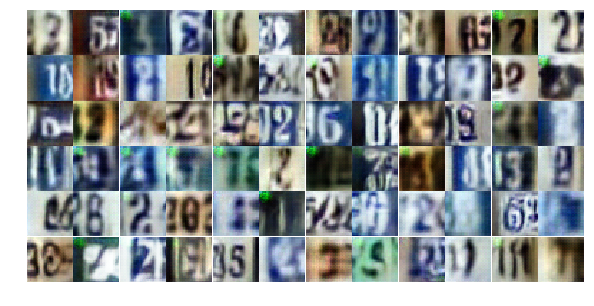

Epoch 20/20... Discriminator Loss: 1.2735... Generator Loss: 0.7452
Epoch 20/20... Discriminator Loss: 1.1596... Generator Loss: 0.7605
Epoch 20/20... Discriminator Loss: 1.0296... Generator Loss: 0.8157
Epoch 20/20... Discriminator Loss: 1.2604... Generator Loss: 0.7703
Epoch 20/20... Discriminator Loss: 1.3557... Generator Loss: 0.7831
Epoch 20/20... Discriminator Loss: 1.4025... Generator Loss: 0.7824
Epoch 20/20... Discriminator Loss: 1.2507... Generator Loss: 0.8027
Epoch 20/20... Discriminator Loss: 1.2491... Generator Loss: 0.7609
Epoch 20/20... Discriminator Loss: 1.3303... Generator Loss: 0.6792
Epoch 20/20... Discriminator Loss: 1.4329... Generator Loss: 0.7522


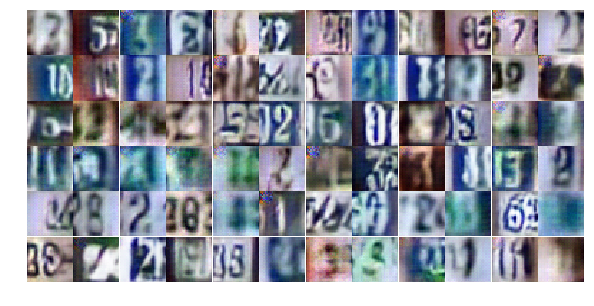

Epoch 20/20... Discriminator Loss: 1.3409... Generator Loss: 0.7683
Epoch 20/20... Discriminator Loss: 1.2006... Generator Loss: 0.8500
Epoch 20/20... Discriminator Loss: 1.0067... Generator Loss: 0.8794
Epoch 20/20... Discriminator Loss: 1.4722... Generator Loss: 0.5301
Epoch 20/20... Discriminator Loss: 1.1146... Generator Loss: 0.9007
Epoch 20/20... Discriminator Loss: 1.2059... Generator Loss: 0.8052


In [141]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

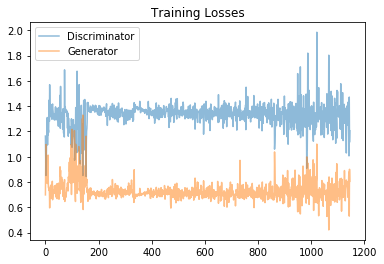

In [142]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

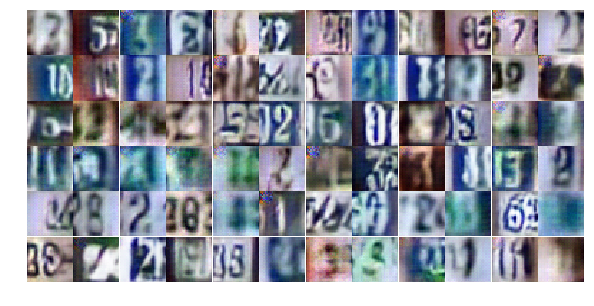

In [143]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))